# 1. NLP_Feature_Engineering Overview
tf-idf, LDA

In [1]:
###################################!pip install --upgrade pip################# upgrade pip ###############################
#python version 3.9 will fix collections import error
#!pip install gensim --verbose
#!pip install emojis matplotlib wordcloud
#!pip install emojis

In [2]:
#!pip install pandas
#!pip install numpy
#!pip install nltk
#!pip install matplotlib
#!pip install spacy
#!pip install re
#!pip install tqdm
#!pip install collections
#!python -m spacy download en_core_web_sm
#! pip install wordcloud

In [3]:
import nltk
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\wuhangze\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\wuhangze\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\wuhangze\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [4]:
import os

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

In [5]:
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.stem import SnowballStemmer
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords

#!python -m spacy download en_core_web_sm
import spacy

import re
from collections import Counter

from tqdm import tqdm
tqdm.pandas()

from wordcloud import WordCloud

## 2. tf-idf, LDA

In [6]:
directory_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/github_thesis/deloitte_digital_banking/tucapital_scraper/downloads/'
translated_news_save_path = "tucapital-news_with_text-translated.csv"

# modify format
# Save the combined DataFrame to a CSV file
df_copy = pd.read_csv(directory_path+translated_news_save_path)
df_copy.head()

,Unnamed: 0,title,url,date,text
0,0,"Tomorrow, last day of the account at 2.89% APR...",https://www.tucapital.es/depositos/manana-ulti...,23/04/2024,"Tomorrow, April 24, 2024, the marketing period..."
1,1,ING gives you up to €120 if you direct your pa...,https://www.tucapital.es/cuentas/ing-te-da-has...,22/04/2024,"ING now asks, in addition to direct debiting a..."
2,2,Banco BIG deposits: slight increase in normal ...,https://www.tucapital.es/depositos/depositos-d...,22/04/2024,Banco BIG remodels its deposit offer with slig...
3,3,The future of Bitcoin: predictions for the nex...,https://www.tucapital.es/blogs/guias/el-futuro...,22/04/2024,"Since its launch, Bitcoin has seen positive an..."
4,4,Eco: Cetelem only allows maximum daily transfe...,https://www.tucapital.es/blogs/eco/eco-cetelem...,19/04/2024,"Due to the disappearance of Orange Bank, and t..."


### 2. Feature Engineering Extraction

In [7]:
# Filter where Not-expected rows
date_pattern = re.compile(r'-\d{2}/\d{2}/\d{4}:')
df_cleaned = df_copy[~df_copy['title'].str.contains(date_pattern)]
# Drop nan
df_cleaned = df_cleaned.dropna(subset=['title', 'url', 'date'])

df_copy.shape, df_cleaned.shape

((1025, 5), (1018, 5))

In [8]:
df_cleaned['combined_text'] = (df_cleaned['title'] + ' ') * 3 + df_cleaned['text']

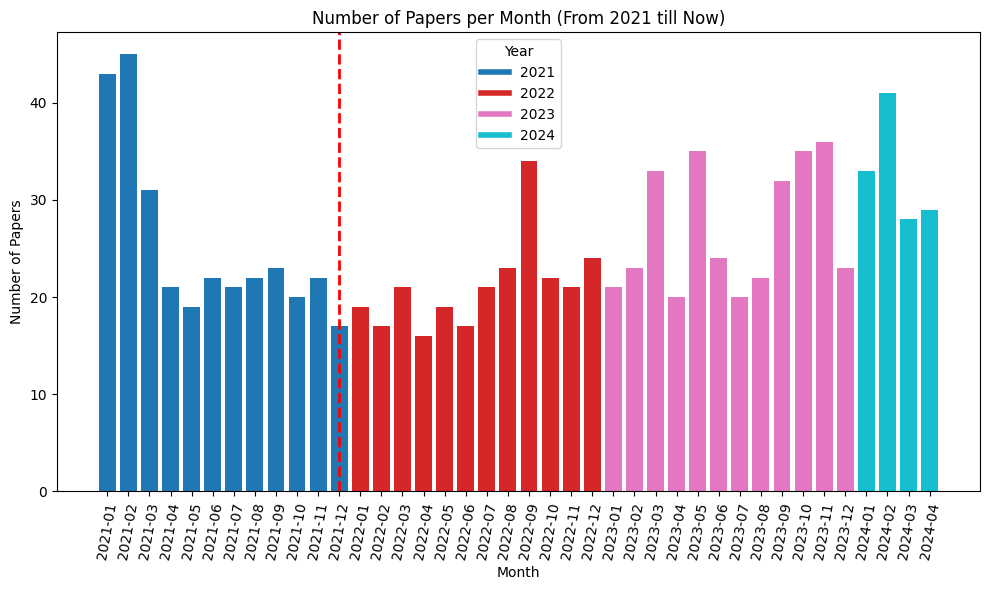

In [9]:
df_cleaned['date'] = pd.to_datetime(df_cleaned['date'])

# Filter the DataFrame to only include dates from 2021 to now
df_filtered = df_cleaned[(df_cleaned['date'] >= '2021-01-01') & (df_cleaned['date'] <= pd.Timestamp.today())]

# Group by month and count entries
df_grouped = df_filtered.groupby(pd.Grouper(key='date', freq='M')).size()

# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))

# Assign colors to each year
years = df_grouped.index.year
unique_years = years.unique()
colors = plt.get_cmap('tab10', len(unique_years))

# Plot each bar with the corresponding color
bars = []
for i, (date, count) in enumerate(df_grouped.items()):
    color = colors(unique_years.tolist().index(date.year))
    bars.append(ax.bar(i, count, color=color))

# Set x-ticks
ax.set_xticks(range(len(df_grouped)))
ax.set_xticklabels([date.strftime('%Y-%m') for date in df_grouped.index], rotation=80)

# Create a custom legend
handles = [plt.Line2D([0], [0], color=colors(i), lw=4) for i in range(len(unique_years))]
labels = unique_years
ax.legend(handles, labels, title='Year')

# Add vertical line for December 2021
start_month_index = df_grouped.index.get_loc('2021-12-31')
ax.axvline(x=start_month_index, color='red', linestyle='--', linewidth=2, label='Start of Web Traffic Data')

# Title and labels
ax.set_title('Number of Papers per Month (From 2021 till Now)')
ax.set_xlabel('Month')
ax.set_ylabel('Number of Papers')

plt.tight_layout()
plt.show()


In [10]:
# Ensure 'combined_text' column is in the DataFrame
df_cleaned['combined_text'] = df_cleaned['combined_text'].astype(str)  # Convert to string in case it's not

# Count the number of words in each entry
df_cleaned['word_count'] = df_cleaned['combined_text'].apply(lambda x: len(x.split()))

# Verify the word counts
df_cleaned.head()

,Unnamed: 0,title,url,date,text,combined_text,word_count
0,0,"Tomorrow, last day of the account at 2.89% APR...",https://www.tucapital.es/depositos/manana-ulti...,2024-04-23,"Tomorrow, April 24, 2024, the marketing period...","Tomorrow, last day of the account at 2.89% APR...",318
1,1,ING gives you up to €120 if you direct your pa...,https://www.tucapital.es/cuentas/ing-te-da-has...,2024-04-22,"ING now asks, in addition to direct debiting a...",ING gives you up to €120 if you direct your pa...,400
2,2,Banco BIG deposits: slight increase in normal ...,https://www.tucapital.es/depositos/depositos-d...,2024-04-22,Banco BIG remodels its deposit offer with slig...,Banco BIG deposits: slight increase in normal ...,476
3,3,The future of Bitcoin: predictions for the nex...,https://www.tucapital.es/blogs/guias/el-futuro...,2024-04-22,"Since its launch, Bitcoin has seen positive an...",The future of Bitcoin: predictions for the nex...,656
4,4,Eco: Cetelem only allows maximum daily transfe...,https://www.tucapital.es/blogs/eco/eco-cetelem...,2024-04-19,"Due to the disappearance of Orange Bank, and t...",Eco: Cetelem only allows maximum daily transfe...,450


In [11]:
# Convert the 'date' column to datetime if not already
df_cleaned['date'] = pd.to_datetime(df_cleaned['date'])

# Filter the DataFrame to only include dates from 2021 to now
df_filtered = df_cleaned[(df_cleaned['date'] >= '2021-01-01') & (df_cleaned['date'] <= pd.Timestamp.today())]

# Group by month and sum the word counts
df_grouped_words = df_filtered.groupby(pd.Grouper(key='date', freq='M'))['word_count'].sum()

# Verify the grouped data
df_grouped_words.head()

date
2021-01-31    25283
2021-02-28    26524
2021-03-31    17448
2021-04-30    11207
2021-05-31     9619
Freq: ME, Name: word_count, dtype: int64

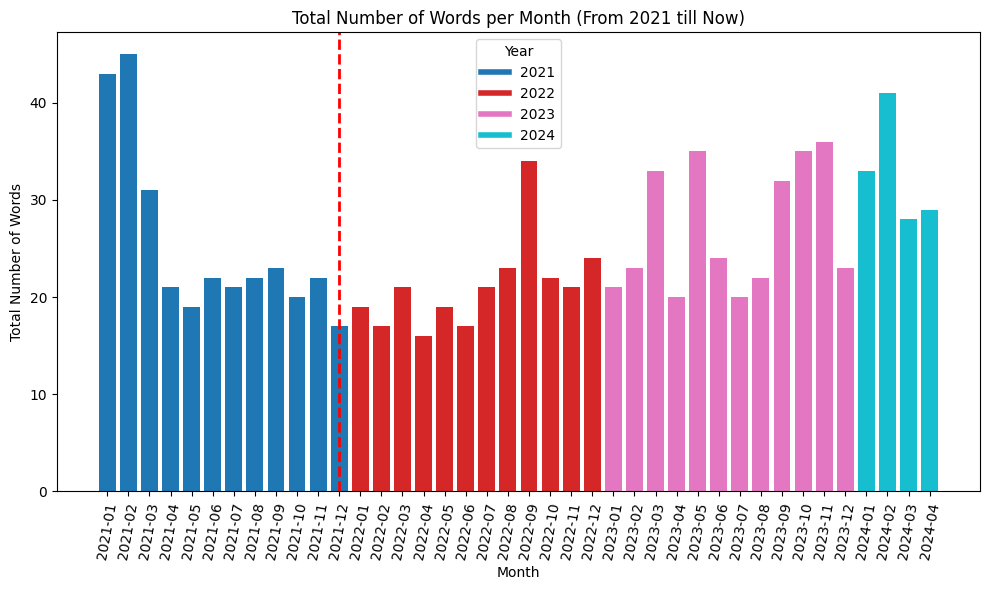

In [12]:
df_cleaned['date'] = pd.to_datetime(df_cleaned['date'])

# Filter the DataFrame to only include dates from 2021 to now
df_filtered = df_cleaned[(df_cleaned['date'] >= '2021-01-01') & (df_cleaned['date'] <= pd.Timestamp.today())]

# Group by month and count entries
df_grouped_words = df_filtered.groupby(pd.Grouper(key='date', freq='M')).size()

# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))

# Assign colors to each year
years = df_grouped_words.index.year
unique_years = years.unique()
colors = plt.get_cmap('tab10', len(unique_years))

# Plot each bar with the corresponding color
bars = []
for i, (date, count) in enumerate(df_grouped_words.items()):
    color = colors(unique_years.tolist().index(date.year))
    bars.append(ax.bar(i, count, color=color))

# Set x-ticks
ax.set_xticks(range(len(df_grouped_words)))
ax.set_xticklabels([date.strftime('%Y-%m') for date in df_grouped_words.index], rotation=80)

# Create a custom legend
handles = [plt.Line2D([0], [0], color=colors(i), lw=4) for i in range(len(unique_years))]
labels = unique_years
ax.legend(handles, labels, title='Year')

# Add vertical line for December 2021
start_month_index = df_grouped_words.index.get_loc('2021-12-31')
ax.axvline(x=start_month_index, color='red', linestyle='--', linewidth=2, label='Start of Web Traffic Data')

# Title and labels
ax.set_title('Total Number of Words per Month (From 2021 till Now)')
ax.set_xlabel('Month')
ax.set_ylabel('Total Number of Words')

plt.tight_layout()  # Adjust layout to make room for label rotation

# Show the plot
plt.show()


In [13]:
# Convert the 'date' column to datetime if not already
df_cleaned['date'] = pd.to_datetime(df_cleaned['date'])

# Filter the DataFrame to only include dates from 2021 to now
df_filtered = df_cleaned[(df_cleaned['date'] >= '2021-01-01') & (df_cleaned['date'] <= pd.Timestamp.today())]

# Group by month and calculate the average word count
df_grouped_avg_words = df_filtered.groupby(pd.Grouper(key='date', freq='M'))['word_count'].mean()

# Verify the grouped data
df_grouped_avg_words.head()


date
2021-01-31    587.976744
2021-02-28    589.422222
2021-03-31    562.838710
2021-04-30    533.666667
2021-05-31    506.263158
Freq: ME, Name: word_count, dtype: float64

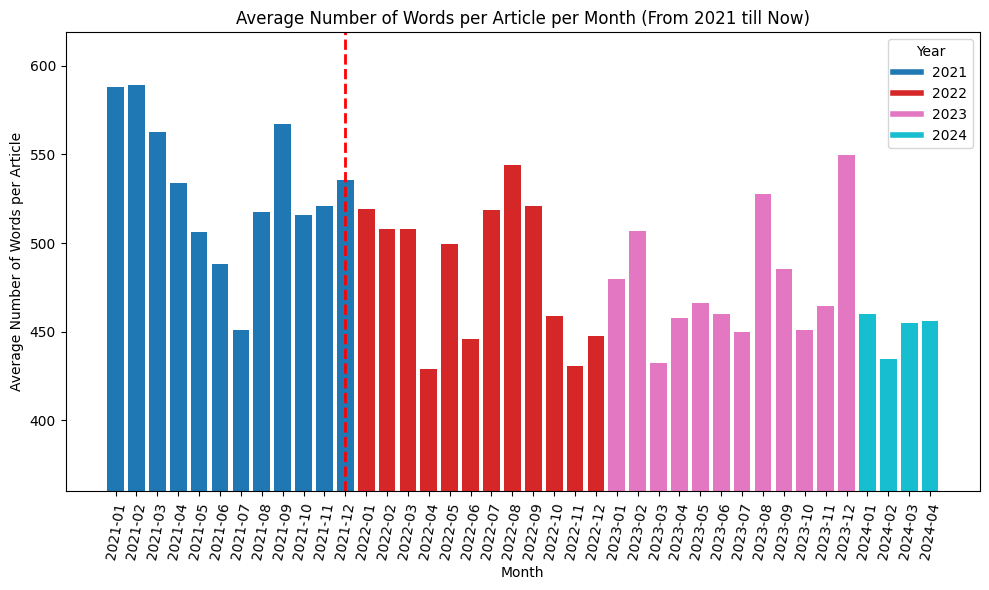

In [14]:
df_cleaned['date'] = pd.to_datetime(df_cleaned['date'])

# Filter the DataFrame to only include dates from 2021 to now
df_filtered = df_cleaned[(df_cleaned['date'] >= '2021-01-01') & (df_cleaned['date'] <= pd.Timestamp.today())]

# Calculate the average number of words per article per month
df_filtered['word_count'] = df_filtered['combined_text'].apply(lambda x: len(str(x).split()))
df_grouped_avg_words = df_filtered.groupby(pd.Grouper(key='date', freq='M'))['word_count'].mean()

# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))

# Assign colors to each year
years = df_grouped_avg_words.index.year
unique_years = years.unique()
colors = plt.get_cmap('tab10', len(unique_years))

# Plot each bar with the corresponding color
bars = []
for i, (date, count) in enumerate(df_grouped_avg_words.items()):
    color = colors(unique_years.tolist().index(date.year))
    bars.append(ax.bar(i, count, color=color))

# Set x-ticks
ax.set_xticks(range(len(df_grouped_avg_words)))
ax.set_xticklabels([date.strftime('%Y-%m') for date in df_grouped_avg_words.index], rotation=80)

# Create a custom legend
handles = [plt.Line2D([0], [0], color=colors(i), lw=4) for i in range(len(unique_years))]
labels = unique_years
ax.legend(handles, labels, title='Year')

# Add vertical line for December 2021
start_month_index = df_grouped_avg_words.index.get_loc('2021-12-31')
ax.axvline(x=start_month_index, color='red', linestyle='--', linewidth=2, label='Start of Web Traffic Data')

# Title and labels
ax.set_title('Average Number of Words per Article per Month (From 2021 till Now)')
ax.set_xlabel('Month')
ax.set_ylabel('Average Number of Words per Article')

# Set y-axis limit to start from 360
ax.set_ylim(360, ax.get_ylim()[1])

plt.tight_layout()  # Adjust layout to make room for label rotation

# Show the plot
plt.show()


#### TF-IDF

#### Tokenizer

In [15]:
#### nlp component setting #####
porter = SnowballStemmer("english")
stop_words = set(stopwords.words('english'))
# Load spaCy model
sp = spacy.load('en_core_web_sm')

mod = 1

def remove_digits(token):
    # Use regex to remove digits
    token_without_digits = re.sub(r'\d+', '', token)
    return token_without_digits

def abbr_or_lower(word):
    if re.match('([A-Z]+[a-z]*){5,}', word):
        return word
    else:
        return word.lower()
    
def tokenize(text, modulation):
    # Define regex for emojis and "!"
    emoji_exclam_pattern = re.compile(r'[\U0001F600-\U0001F64F\U0001F300-\U0001F5FF\U0001F680-\U0001F6FF\U0001F700-\U0001F77F\U0001F780-\U0001F7FF\U0001F800-\U0001F8FF\U0001F900-\U0001F9FF\U0001FA00-\U0001FA6F\U0001FA70-\U0001FAFF\U00002702-\U000027B0\U000024C2-\U0001F251!]')
    
    tokens = []

    cleaned_text = emoji_exclam_pattern.sub(r'', text)
    if modulation < 3:
        for token in re.split(r'\W+', cleaned_text):
            token = remove_digits(token) # remove number
            if token is '': continue
            token = abbr_or_lower(token)
            if token and re.search('[a-zA-Z]', token):
                if modulation == 0:
                    tokens.append(token)
                elif modulation == 1 and token not in stop_words: # remove stop words
                    tokens.append(token)
                elif modulation == 2 and token not in stop_words and porter: # remove stop words + stem
                    tokens.append(porter.stem(token))
        
        # Handle emojis and "!" separately to avoid removing them
        emoji_exclam_tokens = emoji_exclam_pattern.findall(text)
        for token in emoji_exclam_tokens:
            if token == '!':
                tokens.append(token)
            elif modulation < 2 and token in stop_words:
                continue  # If an emoji is somehow in stop_words, skip it
            else:
                tokens.append(token)
        
    else:
        # Handling for modulation >= 2, potentially using spaCy or other logic
        pass  # Implement as necessary
    
    return tokens

def custom_tokenizer(text):
    tokens = tokenize(text, modulation=mod)
    return tokens

In [16]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Initialize TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer(tokenizer=custom_tokenizer,ngram_range=(1, 5), max_df=0.6, min_df=0.0001)

# Fit and transform the cleaned text data
tfidf_features = tfidf_vectorizer.fit_transform(df_cleaned['combined_text'])

# Convert to dense matrix (if needed)
tfidf_features_dense = tfidf_features.toarray()

# Get feature names
feature_names = tfidf_vectorizer.get_feature_names_out()

In [17]:
import numpy as np

# Sum tf-idf scores for each term
term_scores = np.sum(tfidf_features_dense, axis=0)

# Create a dictionary to store terms and their scores
term_score_dict = {term: score for term, score in zip(feature_names, term_scores)}

# Sort terms by their scores in descending order
sorted_terms = sorted(term_score_dict.items(), key=lambda x: x[1], reverse=True)

print("Top 50: ")
# Print the top 100 terms with their scores
for term, score in sorted_terms[:50]:
    print(f"{term}: {score}")


print("\n\nLast 20: ")
# Print the top 100 terms with their scores
for term, score in sorted_terms[-30:]:
    print(f"{term}: {score}")
print("\n\nLength of terms: ",len(term_score_dict))

Top 50: 
deposits: 20.384030147316075
payroll: 18.063763487015244
orange: 17.521620954259564
orange bank: 14.832735704498491
ing: 13.698935508035103
banco: 13.523303117532224
money: 12.267865351039553
term: 10.715432793074221
account apr: 10.668963646802133
renault: 10.479687244904062
renault bank: 10.469111474458579
commissions: 10.252556683569555
wizink: 9.721938844186875
online: 9.180122539241538
year: 9.087122758821138
deposit apr: 8.922031959840965
customers: 8.338091522746076
sabadell: 8.185232050110406
ebn: 8.05674206993865
products: 7.950156338324928
savings: 7.897852784336893
interest: 7.78683631243371
income: 7.670591322689949
myinvestor: 7.660101981291231
also: 7.615211613658514
bbva: 7.532468141934313
conditions: 7.486656687515755
per: 7.453596956952981
card: 7.366428304717807
openbank: 7.33695742457257
today: 7.2450294223736
accounts: 7.230326651675086
one: 7.111767899047371
pibank: 7.071331098864143
direct: 7.051863905628085
period: 7.02748929734572
santander: 7.004035488

#### 'bank' related terms

In [48]:
import re

patterns = [
    # Single gram concatenated terms containing "bank" or "banco"
    re.compile(r'\b(?!bank\b|banco\b)\w*(bank|banco)\w*\b'),               
  
    # Bigram patterns
    #re.compile(r'\b\w+\s+(bank|banco)\b'),                                   # ... bank or banco
    #re.compile(r'\b(bank|banco)\s+\w+\b'),                                   # bank or banco ...
  
    # Trigram patterns
    re.compile(r'\b\w+\s+(bank|banco)\s+\w+\b'),                             # ... bank or banco ...
    re.compile(r'\b(bank|banco)\s+\w+\s+\w+\b'),                             # bank or banco ... ...
    re.compile(r'\b\w+\s+\w+\s+(bank|banco)\b'),                             # ... ... bank or banco
  
    # Four-gram patterns
    re.compile(r'\b\w+\s+\w+\s+(bank|banco)\s+\w+\b'),                       # ... ... bank or banco ...
    re.compile(r'\b(bank|banco)\s+\w+\s+\w+\s+\w+\b'),                       # bank or banco ... ... ...
    re.compile(r'\b\w+\s+\w+\s+\w+\s+(bank|banco)\b'),                       # ... ... ... bank or banco
  
    # Five-gram patterns
    re.compile(r'\b\w+\s+\w+\s+\w+\s+(bank|banco)\s+\w+\b'),                 # ... ... ... bank or banco ...
    re.compile(r'\b(bank|banco)\s+\w+\s+\w+\s+\w+\s+\w+\b'),                 # bank or banco ... ... ... ...
    re.compile(r'\b\w+\s+\w+\s+\w+\s+\w+\s+(bank|banco)\b')                  # ... ... ... ... bank or banco
]

# Dictionary to hold filtered terms
filtered_terms = {}

# Check each term in the dictionary
for term, score in term_score_dict.items():
    # Ensure "bank" or "banco" is standalone
    if any(pattern.match(term) for pattern in patterns) and ('bank' in term.split() or 'banco' in term.split()):
        if score >= 1:
            filtered_terms[term] = score

# Sort the filtered terms by score in descending order
sorted_terms = sorted(filtered_terms.items(), key=lambda x: x[1], reverse=True)
# Print the filtered terms and their scores
for term, score in sorted_terms:
    print(f"Term: {term}, TF-IDF Score: {score:.4f}")

print("\n\nLength of terms: ",len(sorted_terms))

Term: orange bank account, TF-IDF Score: 3.9545
Term: orange bank either, TF-IDF Score: 3.5777
Term: anyone orange bank, TF-IDF Score: 3.5750
Term: anyone orange bank account, TF-IDF Score: 3.5750
Term: anyone orange bank account know, TF-IDF Score: 3.5750
Term: bank account know, TF-IDF Score: 3.5750
Term: bank account know going, TF-IDF Score: 3.5750
Term: bank account know going lose, TF-IDF Score: 3.5750
Term: bank either atms, TF-IDF Score: 3.5750
Term: bank either atms fail, TF-IDF Score: 3.5750
Term: bank either atms fail operation, TF-IDF Score: 3.5750
Term: equals surpasses orange bank, TF-IDF Score: 3.5750
Term: equals surpasses orange bank either, TF-IDF Score: 3.5750
Term: offer equals surpasses orange bank, TF-IDF Score: 3.5750
Term: orange bank account know, TF-IDF Score: 3.5750
Term: orange bank account know going, TF-IDF Score: 3.5750
Term: orange bank either atms, TF-IDF Score: 3.5750
Term: orange bank either atms fail, TF-IDF Score: 3.5750
Term: surpasses orange bank,

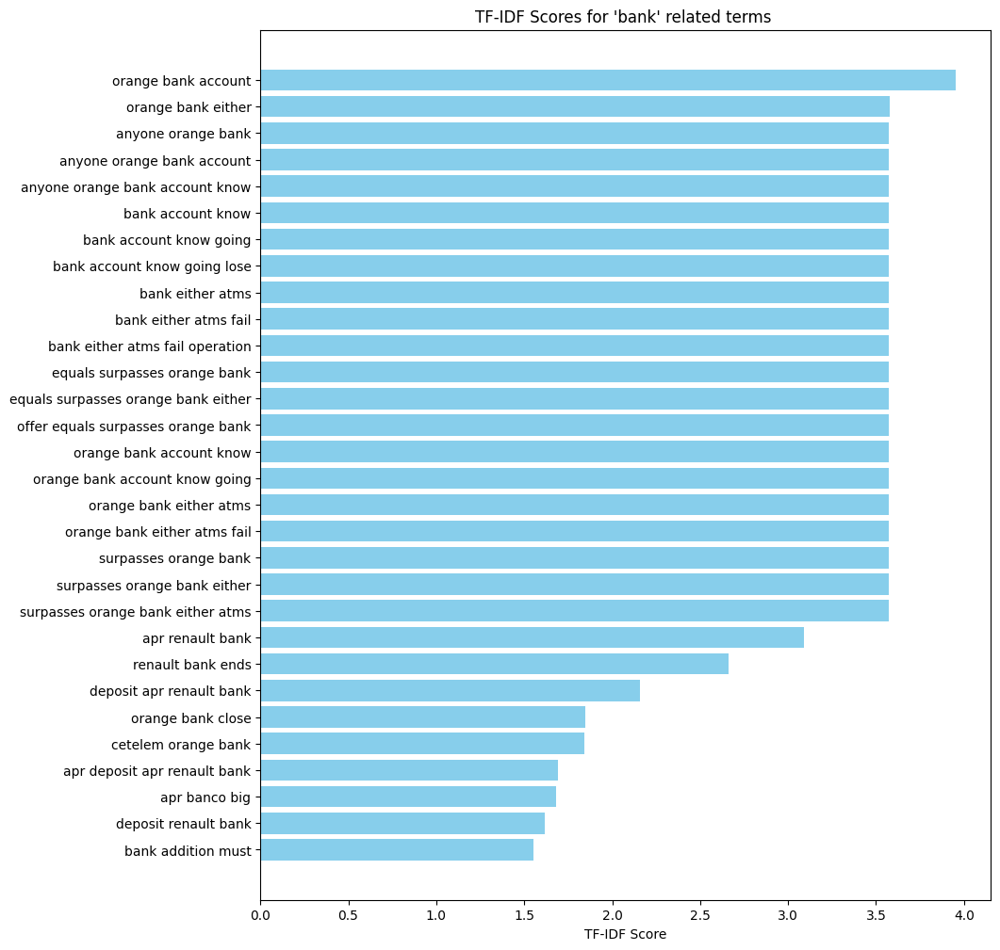

In [49]:
plot_sorted_terms = sorted_terms[:30]
terms, scores = zip(*plot_sorted_terms)

plt.figure(figsize=(10, 12))
plt.barh(terms, scores, color='skyblue')
plt.xlabel('TF-IDF Score')
plt.title('TF-IDF Scores for \'bank\' related terms ')
plt.gca().invert_yaxis()  # Invert y-axis to have the highest scores at the top
plt.show()

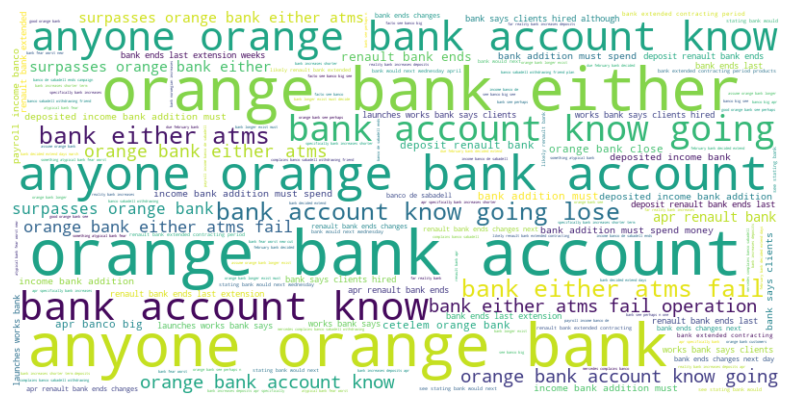

In [20]:
# Converting sorted_terms back to a dictionary
filtered_term_score_dict = dict(sorted_terms)
# Generate the word cloud
wordcloud = WordCloud(
    width = 800, 
    height = 400, 
    background_color = 'white'
).generate_from_frequencies(filtered_term_score_dict)

# Displaying the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')  # 'bilinear' for smoother appearance
plt.axis('off')  # No axis to be shown
plt.show()

Total terms before filtering: 385486
Total terms after filtering: 333636


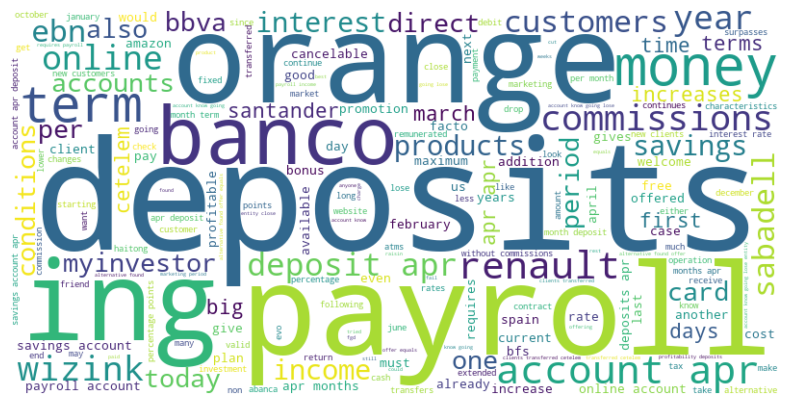

In [45]:
not_bank_filtered_terms = {}

patterns = [
    # Single gram concatenated terms containing "bank" or "banco"
    re.compile(r'\b(?!bank\b|banco\b)\w*(bank|banco)\w*\b'),               
  
    # Bigram patterns
    re.compile(r'\b\w+\s+(bank|banco)\b'),                                   # ... bank or banco
    re.compile(r'\b(bank|banco)\s+\w+\b'),                                   # bank or banco ...
]

# Check each term in the dictionary
for term, score in term_score_dict.items():
    if not(any(pattern.search(term) for pattern in patterns)):
        not_bank_filtered_terms[term] = score

# Print the number of terms before and after filtering
print(f"Total terms before filtering: {len(term_score_dict)}")
print(f"Total terms after filtering: {len(not_bank_filtered_terms)}")

# Sort the filtered terms by score in descending order
not_bank_sorted_terms = sorted(not_bank_filtered_terms.items(), key=lambda x: x[1], reverse=True)

# Generate the word cloud if there are any terms left after filtering
if not_bank_sorted_terms:
    plot_term_score_dict = dict(not_bank_sorted_terms)
    # Generate the word cloud
    wordcloud = WordCloud(
        width = 800, 
        height = 400, 
        background_color = 'white'
    ).generate_from_frequencies(plot_term_score_dict)

    # Displaying the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')  # 'bilinear' for smoother appearance
    plt.axis('off')  # No axis to be shown
    plt.show()
else:
    print("No terms available to generate a word cloud.")

### yearly tf-idf

In [22]:
df_cleaned['date'] = pd.to_datetime(df_cleaned['date'])

# Extract year from the date
df_cleaned['year'] = df_cleaned['date'].dt.year


In [50]:
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
import re

def compute_tfidf_scores(df, patterns):
    # Initialize TF-IDF vectorizer
    tfidf_vectorizer = TfidfVectorizer(tokenizer=custom_tokenizer, ngram_range=(1, 3), max_df=0.6, min_df=0.005)

    # Fit and transform the cleaned text data
    tfidf_features = tfidf_vectorizer.fit_transform(df['combined_text'])

    # Convert to dense matrix (if needed)
    tfidf_features_dense = tfidf_features.toarray()

    # Get feature names
    feature_names = tfidf_vectorizer.get_feature_names_out()

    # Sum tf-idf scores for each term
    term_scores = np.sum(tfidf_features_dense, axis=0)

    # Create a dictionary to store terms and their scores
    term_score_dict = {term: score for term, score in zip(feature_names, term_scores)}

    # Dictionary to hold filtered terms
    filtered_terms = {}

    # Check each term in the dictionary
    for term, score in term_score_dict.items():
        # Ensure "bank" or "banco" is standalone
        if any(pattern.match(term) for pattern in patterns) and ('bank' in term.split() or 'banco' in term.split()):
            if score >= 0.5:
                filtered_terms[term] = score

    # Sort the filtered terms by score in descending order
    sorted_terms = sorted(filtered_terms.items(), key=lambda x: x[1], reverse=True)

    return sorted_terms

patterns = [
    # Single gram concatenated terms containing "bank" or "banco"
    re.compile(r'\b(?!bank\b|banco\b)\w*(bank|banco)\w*\b'),               
  
    # Bigram patterns
    #re.compile(r'\b\w+\s+(bank|banco)\b'),                                   # ... bank or banco
    #re.compile(r'\b(bank|banco)\s+\w+\b'),                                   # bank or banco ...
  
    # Trigram patterns
    re.compile(r'\b\w+\s+(bank|banco)\s+\w+\b'),                             # ... bank or banco ...
    re.compile(r'\b(bank|banco)\s+\w+\s+\w+\b'),                             # bank or banco ... ...
    re.compile(r'\b\w+\s+\w+\s+(bank|banco)\b'),                             # ... ... bank or banco
  
    # Four-gram patterns
    re.compile(r'\b\w+\s+\w+\s+(bank|banco)\s+\w+\b'),                       # ... ... bank or banco ...
    re.compile(r'\b(bank|banco)\s+\w+\s+\w+\s+\w+\b'),                       # bank or banco ... ... ...
    re.compile(r'\b\w+\s+\w+\s+\w+\s+(bank|banco)\b'),                       # ... ... ... bank or banco
  
    # Five-gram patterns
    re.compile(r'\b\w+\s+\w+\s+\w+\s+(bank|banco)\s+\w+\b'),                 # ... ... ... bank or banco ...
    re.compile(r'\b(bank|banco)\s+\w+\s+\w+\s+\w+\s+\w+\b'),                 # bank or banco ... ... ... ...
    re.compile(r'\b\w+\s+\w+\s+\w+\s+\w+\s+(bank|banco)\b')                  # ... ... ... ... bank or banco
]

# Group by year and compute TF-IDF scores for each year
yearly_tfidf_scores = {}
for year, group in df_cleaned.groupby('year'):
    yearly_tfidf_scores[year] = compute_tfidf_scores(group, patterns)


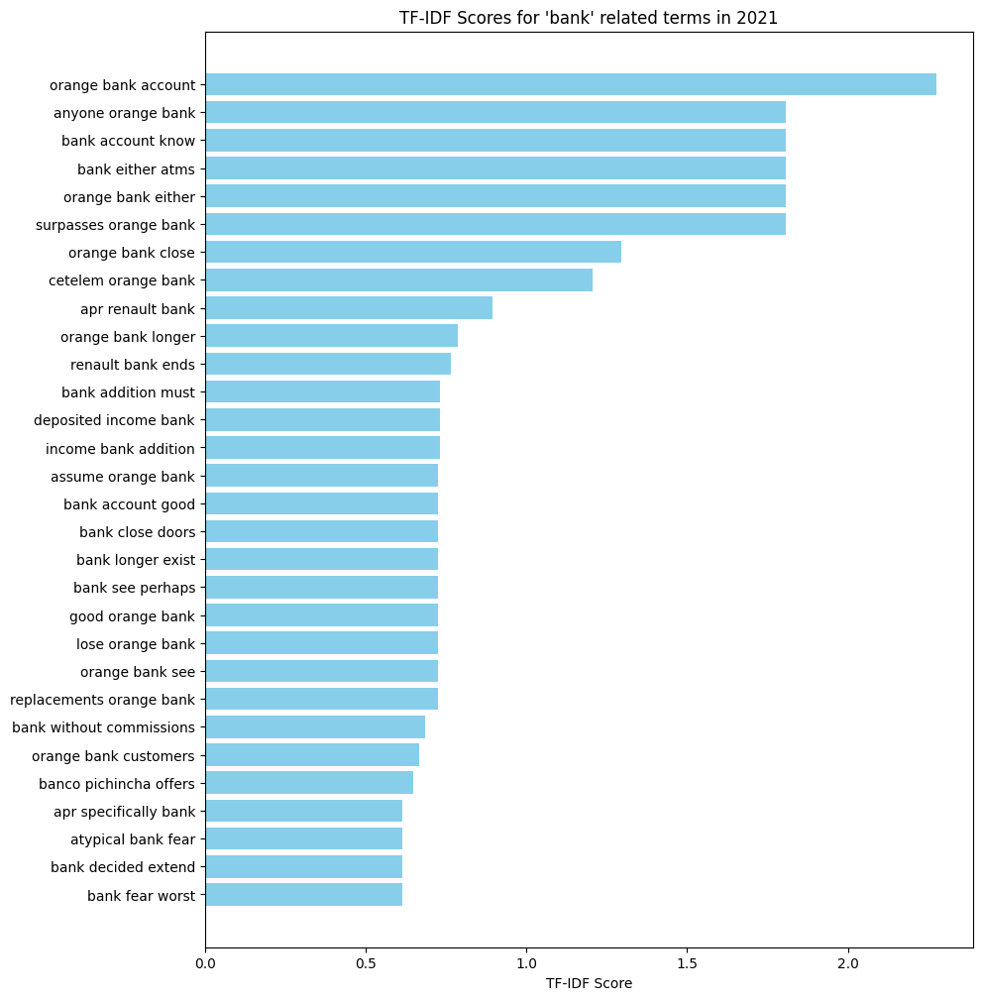

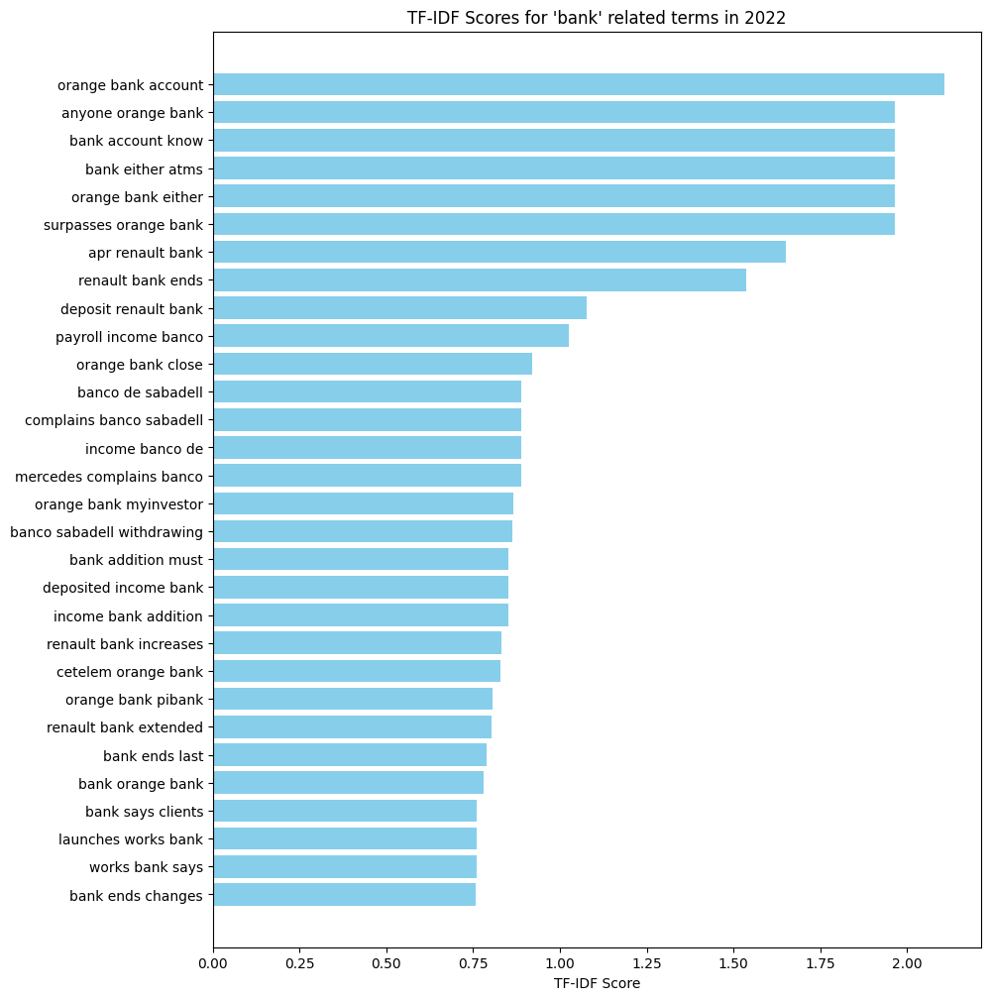

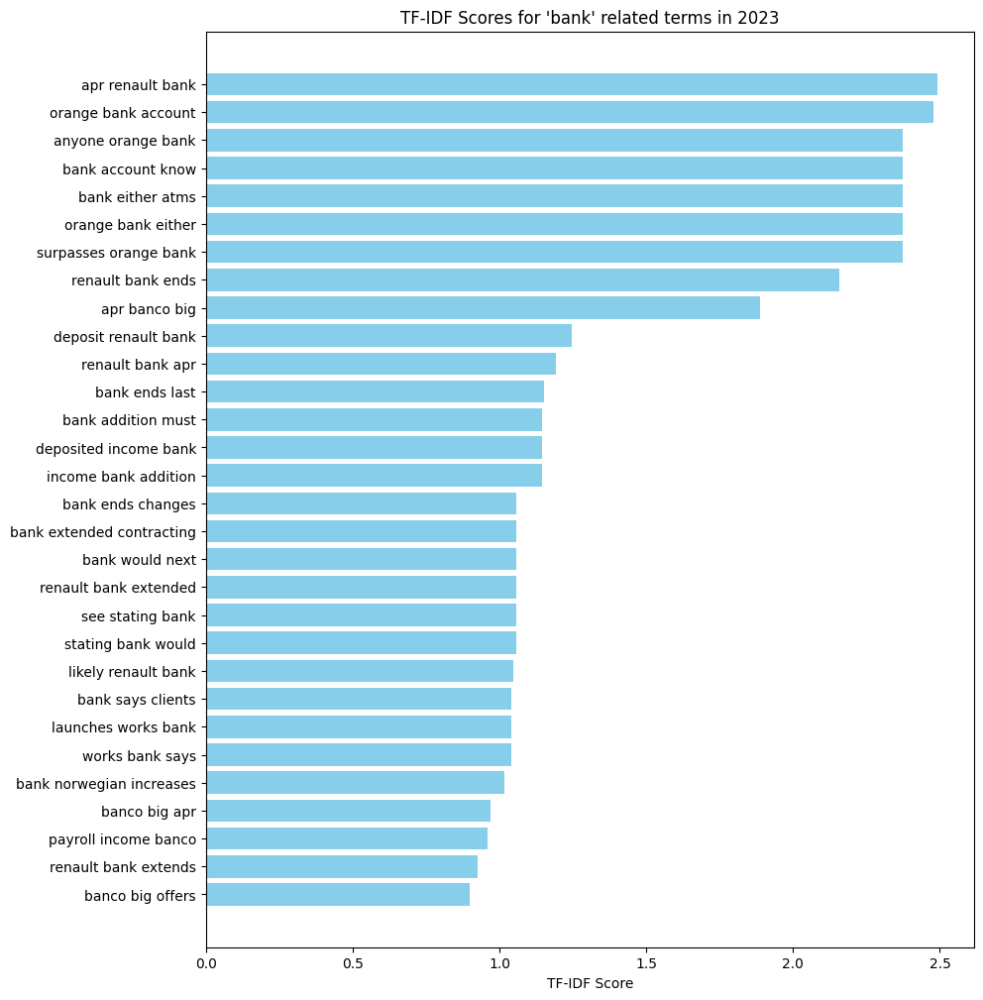

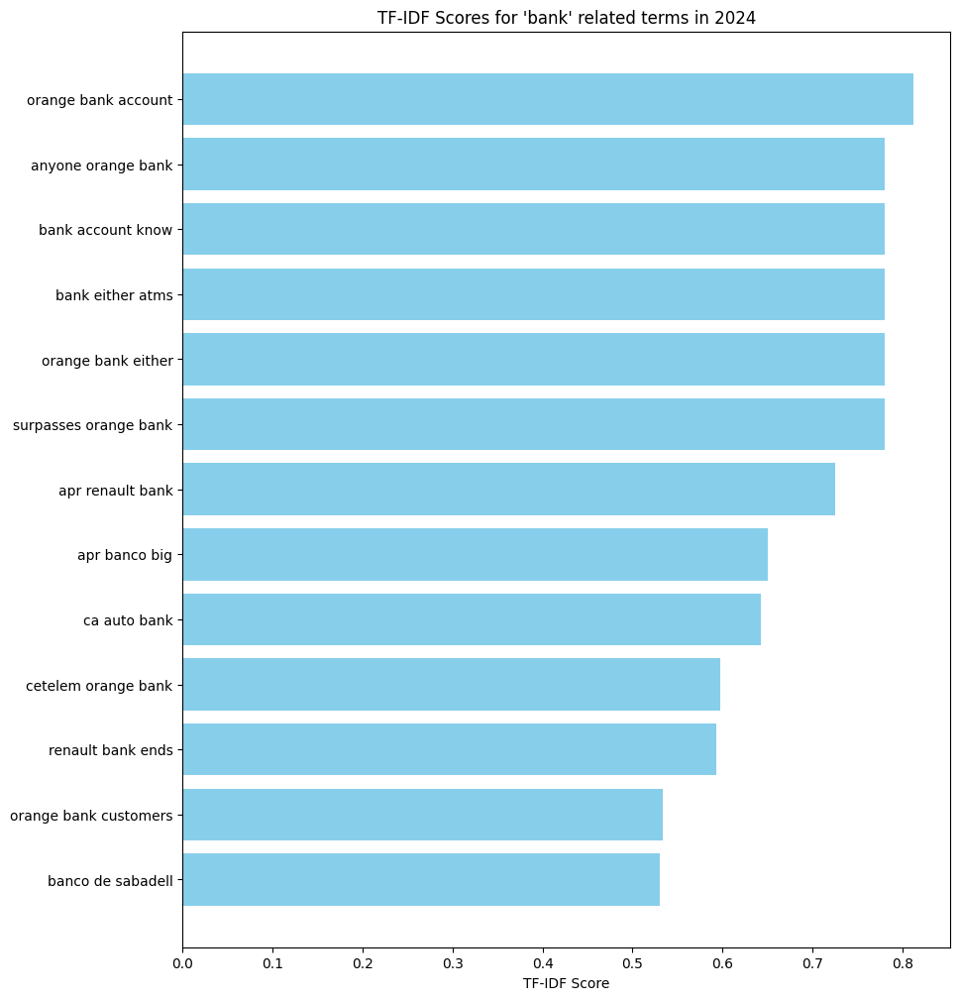

In [51]:
filtered_yearly_tfidf_scores = {year: terms for year, terms in yearly_tfidf_scores.items() if terms}

for year, sorted_terms in filtered_yearly_tfidf_scores.items():
    plot_sorted_terms = sorted_terms[:30]  # Adjust number of terms to plot as needed
    terms, scores = zip(*plot_sorted_terms)

    plt.figure(figsize=(10, 12))
    plt.barh(terms, scores, color='skyblue')
    plt.xlabel('TF-IDF Score')
    plt.title(f'TF-IDF Scores for \'bank\' related terms in {year}')
    plt.gca().invert_yaxis()  # Invert y-axis to have the highest scores at the top
    plt.show()

#### LDA - topic modelling

In [25]:
'''from collections.abc import Mapping
from gensim import corpora, models
import pprint
'''

'from collections.abc import Mapping\nfrom gensim import corpora, models\nimport pprint\n'

In [26]:
'''#!pip install gensim
!pip install --use-pep517 gensim==3.8.0
!pip install scipy==1.10.1'''

'#!pip install gensim\n!pip install --use-pep517 gensim==3.8.0\n!pip install scipy==1.10.1'

In [27]:
def tokenizer_for_df(text, mod = 0):
    tokens = tokenize(text, mod)
    return " ".join(tokens)

def load_bar(corpus_data, col, mod = 0):
    # Percentage load bar
    text_preproc = corpus_data[col].astype(str).progress_apply(lambda row: tokenizer_for_df(row, mod))
    corpus_data[col] = text_preproc
    print(f'done with column: {col}')


def tokenizer_for_df_fit(corpus_data, mod = 0):
    # Load with bar and requires a mod value
    load_bar(corpus_data, "combined_text", mod)

    corpus_data = corpus_data.dropna(subset=["combined_text"]).reset_index(drop=True)
    corpus_data = corpus_data[["title", "url", "date", "text", "combined_text", "word_count"]]

    return corpus_data

In [28]:
df_copy = df_cleaned
df_copy = tokenizer_for_df_fit(df_copy,mod = 1)

df_copy.head()

100%|██████████| 1018/1018 [00:01<00:00, 725.66it/s]

done with column: combined_text


,title,url,date,text,combined_text,word_count
0,"Tomorrow, last day of the account at 2.89% APR...",https://www.tucapital.es/depositos/manana-ulti...,2024-04-23,"Tomorrow, April 24, 2024, the marketing period...",tomorrow last day account apr deposit apr rena...,318
1,ING gives you up to €120 if you direct your pa...,https://www.tucapital.es/cuentas/ing-te-da-has...,2024-04-22,"ING now asks, in addition to direct debiting a...",ing gives direct payroll pay card ing gives di...,400
2,Banco BIG deposits: slight increase in normal ...,https://www.tucapital.es/depositos/depositos-d...,2024-04-22,Banco BIG remodels its deposit offer with slig...,banco big deposits slight increase normal comb...,476
3,The future of Bitcoin: predictions for the nex...,https://www.tucapital.es/blogs/guias/el-futuro...,2024-04-22,"Since its launch, Bitcoin has seen positive an...",future bitcoin predictions next years future b...,656
4,Eco: Cetelem only allows maximum daily transfe...,https://www.tucapital.es/blogs/eco/eco-cetelem...,2024-04-19,"Due to the disappearance of Orange Bank, and t...",eco cetelem allows maximum daily transfers eco...,450


In [29]:
#pip install "scipy<1.13"

In [123]:
num_topics = 50

def custom_tokenizer_mod_1(text):
    tokens = tokenize(text, modulation=1)
    return tokens

from gensim import corpora, models
import pprint


# Tokenize the documents
tokenized_documents = df_copy['combined_text'].apply(custom_tokenizer_mod_1).tolist()

# Create dictionary and corpus
dictionary = corpora.Dictionary(tokenized_documents)
corpus = [dictionary.doc2bow(doc) for doc in tokenized_documents]

# Train the LDA model
lda_model = models.LdaModel(corpus, num_topics= num_topics, id2word=dictionary)

# Print the topics
pprint.pprint(lda_model.print_topics())

[(45,
  '0.024*"apr" + 0.024*"payroll" + 0.022*"account" + 0.021*"bank" + '
  '0.014*"clients" + 0.013*"banco" + 0.012*"new" + 0.010*"offer" + '
  '0.010*"without" + 0.009*"also"'),
 (6,
  '0.039*"apr" + 0.035*"account" + 0.027*"bank" + 0.018*"money" + '
  '0.012*"deposits" + 0.010*"payroll" + 0.010*"offer" + 0.010*"clients" + '
  '0.009*"new" + 0.008*"profitability"'),
 (34,
  '0.022*"account" + 0.018*"bank" + 0.014*"commissions" + 0.013*"without" + '
  '0.012*"apr" + 0.011*"new" + 0.009*"ing" + 0.009*"conditions" + '
  '0.009*"clients" + 0.007*"entity"'),
 (23,
  '0.043*"apr" + 0.034*"bank" + 0.029*"account" + 0.020*"deposit" + '
  '0.017*"renault" + 0.011*"offer" + 0.010*"offers" + 0.010*"profitability" + '
  '0.008*"month" + 0.007*"clients"'),
 (40,
  '0.015*"payroll" + 0.012*"new" + 0.010*"bank" + 0.010*"account" + '
  '0.008*"offer" + 0.007*"clients" + 0.007*"entity" + 0.007*"online" + '
  '0.006*"income" + 0.006*"first"'),
 (33,
  '0.067*"apr" + 0.034*"deposits" + 0.018*"deposit

##### when we only lower-case and remove digits, interesting part appears, importance of emojs appeared in some topics and even appeared at top6, (9, '0.080*"!" + 0.037*"to" + 0.033*"very" + 0.033*"beautiful" + 0.032*"do" + ' '0.028*"a" + 0.025*"\👍" + 0.025*"nice" + 0.019*"experience" + 0.019*"queues"'). As we didn't remove stop words, too much confusing-information appears.</br>

#### We will use remove stop-words and do stemming for join purpose for next LDA analysis.

In [124]:
# Using get_document_topics with an explicit minimum_probability
doc_topics = [lda_model.get_document_topics(item, minimum_probability=0.0000001) for item in corpus]

#note you could also use this vector = [lda[item] for item in corpus] but this has a higher threshold. 
#I like my topic vectors complete!

#this produces a lits of tuples
print(doc_topics[0])

[(0, 0.00012821241), (1, 0.00012821241), (2, 0.00012821241), (3, 0.00012821241), (4, 0.00012821241), (5, 0.00012821241), (6, 0.00012821241), (7, 0.00012821241), (8, 0.00012821241), (9, 0.00012821241), (10, 0.00012821241), (11, 0.00012821241), (12, 0.00012821241), (13, 0.9937176), (14, 0.00012821241), (15, 0.00012821241), (16, 0.00012821241), (17, 0.00012821241), (18, 0.00012821241), (19, 0.00012821241), (20, 0.00012821241), (21, 0.00012821241), (22, 0.00012821241), (23, 0.00012821241), (24, 0.00012821241), (25, 0.00012821241), (26, 0.00012821241), (27, 0.00012821241), (28, 0.00012821241), (29, 0.00012821241), (30, 0.00012821241), (31, 0.00012821241), (32, 0.00012821241), (33, 0.00012821241), (34, 0.00012821241), (35, 0.00012821241), (36, 0.00012821241), (37, 0.00012821241), (38, 0.00012821241), (39, 0.00012821241), (40, 0.00012821241), (41, 0.00012821241), (42, 0.00012821241), (43, 0.00012821241), (44, 0.00012821241), (45, 0.00012821241), (46, 0.00012821241), (47, 0.00012821241), (48, 

We observed that for 1st review, review relevance to most topics are very small, all around than 0.011112. Probably because small topics number, but we should allow this happened, as our reviews number is large but short for each.

In [125]:
topics = lda_model.show_topics(num_topics=-1, num_words=50, formatted=False)
topics

[(0,
  [('money', 0.020644989),
   ('bank', 0.017471533),
   ('apr', 0.014741684),
   ('account', 0.012538207),
   ('new', 0.011398833),
   ('clients', 0.008996781),
   ('banco', 0.00833385),
   ('deposit', 0.008116954),
   ('month', 0.0074100485),
   ('bitcoin', 0.0072889836),
   ('term', 0.006344628),
   ('evo', 0.006171588),
   ('payroll', 0.0058917273),
   ('deposits', 0.00586892),
   ('one', 0.0058122054),
   ('offers', 0.0057862764),
   ('also', 0.0054502035),
   ('time', 0.0052231303),
   ('entity', 0.0049255723),
   ('offer', 0.0047790813),
   ('months', 0.00476667),
   ('first', 0.0046341647),
   ('rate', 0.004478386),
   ('interest', 0.0039297785),
   ('without', 0.0035495434),
   ('sabadell', 0.0035475385),
   ('pay', 0.0034912548),
   ('return', 0.0034175492),
   ('see', 0.003306076),
   ('today', 0.0032891133),
   ('like', 0.0032350328),
   ('plan', 0.0032232634),
   ('income', 0.0030986457),
   ('raisin', 0.003059955),
   ('profitability', 0.0029697784),
   ('mining', 0.0

In [142]:
# Iterate through each topic and its associated terms
detection_term = 'casino'
for topic_num, terms in topics:
    for term, weight in terms:
        if term == detection_term:
            print(f"Topic {topic_num} contains the term '{detection_term}' with weight {weight}")

Topic 1 contains the term 'casino' with weight 0.005496997386217117
Topic 7 contains the term 'casino' with weight 0.0034563099034130573
Topic 15 contains the term 'casino' with weight 0.0021924334578216076
Topic 17 contains the term 'casino' with weight 0.006892313249409199
Topic 22 contains the term 'casino' with weight 0.0025372912641614676
Topic 24 contains the term 'casino' with weight 0.0028708972968161106
Topic 34 contains the term 'casino' with weight 0.003609494771808386
Topic 39 contains the term 'casino' with weight 0.003088046330958605
Topic 40 contains the term 'casino' with weight 0.003102477639913559


In [127]:
# Iterate through each topic and its associated terms
detection_term = 'bitcoin'
for topic_num, terms in topics:
    for term, weight in terms:
        if term == detection_term:
            print(f"Topic {topic_num} contains the term '{detection_term}' with weight {weight}")

Topic 0 contains the term 'casino' with weight 0.007288983557373285
Topic 13 contains the term 'casino' with weight 0.004969173576682806
Topic 15 contains the term 'casino' with weight 0.015244193375110626
Topic 17 contains the term 'casino' with weight 0.006061244290322065
Topic 22 contains the term 'casino' with weight 0.004701096564531326
Topic 24 contains the term 'casino' with weight 0.005651234649121761
Topic 43 contains the term 'casino' with weight 0.015255199745297432


In [141]:
# Iterate through each topic and its associated terms
detection_term = 'forex'
for topic_num, terms in topics:
    for term, weight in terms:
        if term == detection_term:
            print(f"Topic {topic_num} contains the term '{detection_term}' with weight {weight}")

Topic 9 contains the term 'forex' with weight 0.00624270411208272


In [128]:
#!pip install emojis

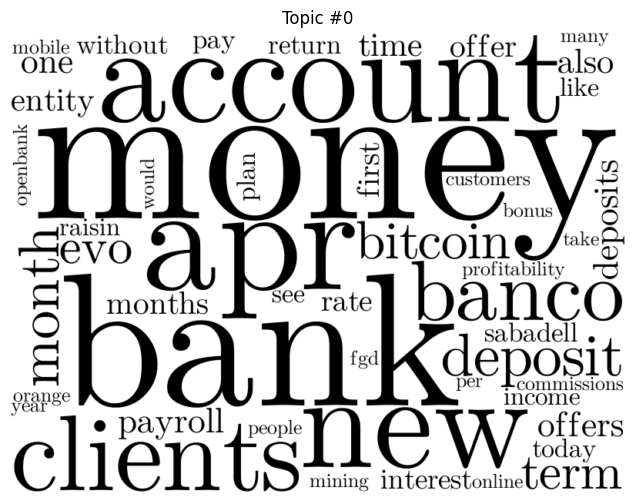

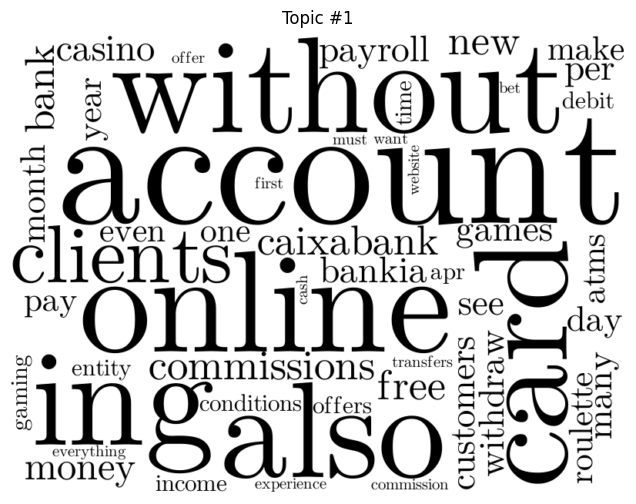

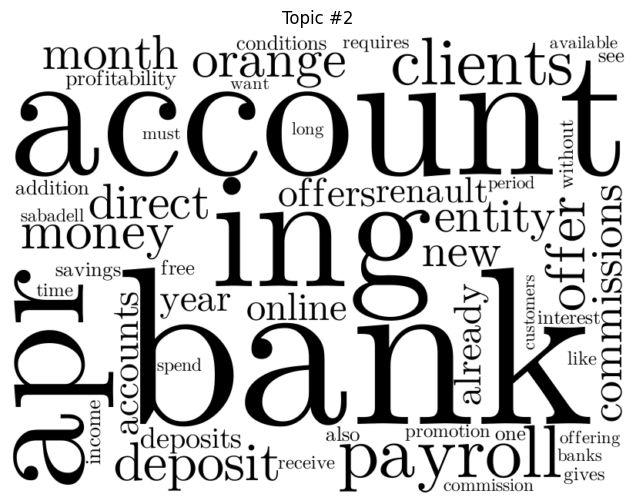

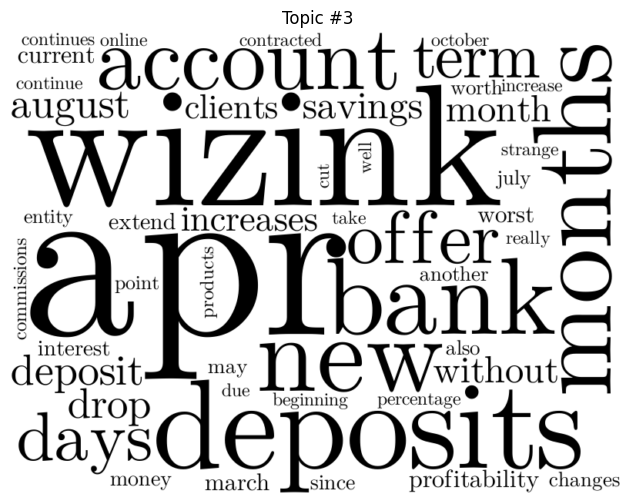

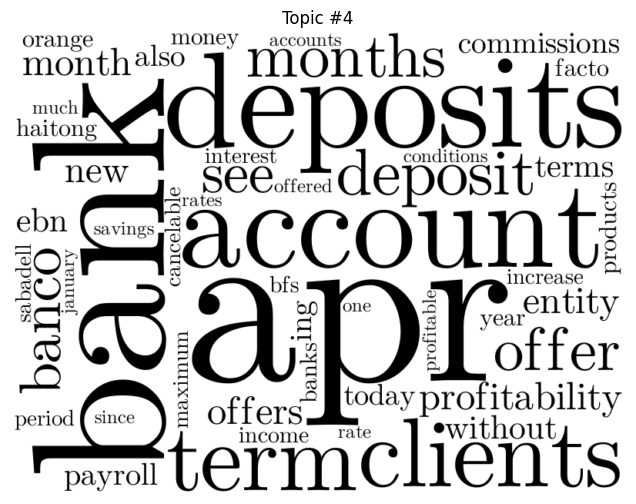

...

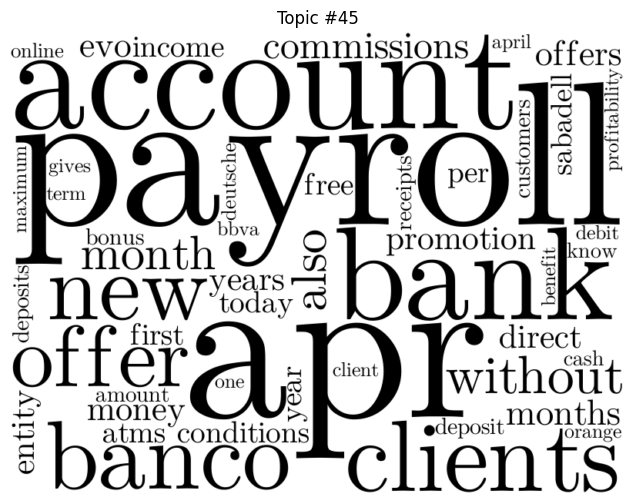

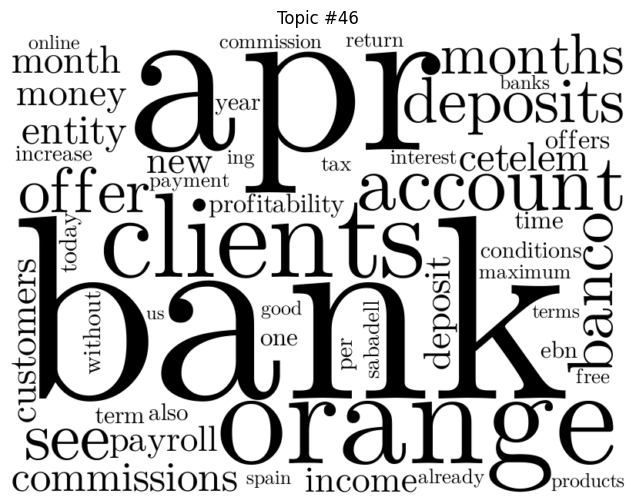

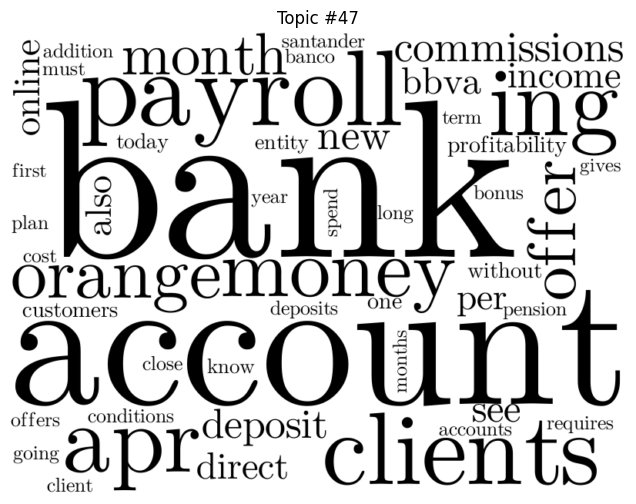

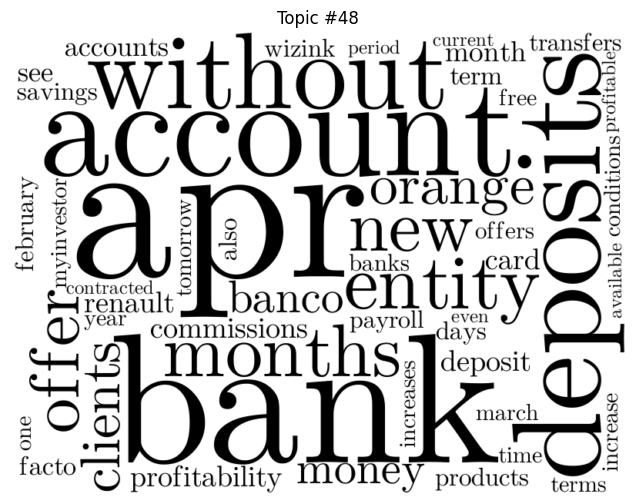

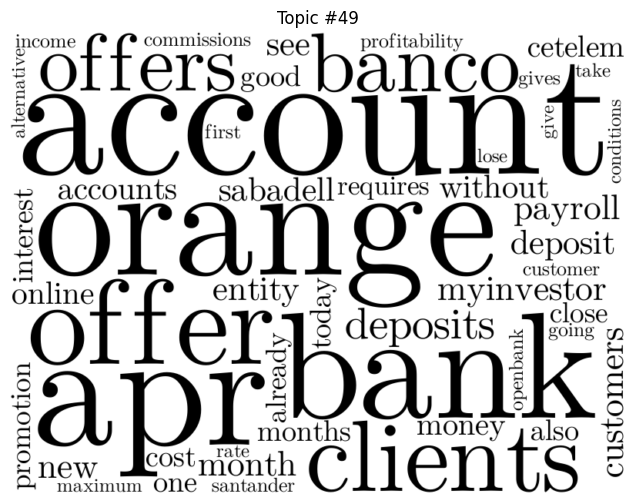

In [129]:
from wordcloud import WordCloud
import emojis

# Define a font path that supports emojis
font_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/github_thesis/deloitte_digital_banking/tucapital_scraper/emoj_Symbola/Symbola.otf'

def generate_wordclouds(topics, dictionary,font_path):
    for topic_num, topic_words in topics:
        word_freq = dict(topic_words)
        wordcloud = WordCloud(
            width=800,
            height=600,
            background_color='white',
            color_func=lambda *args, **kwargs: "black",  # Default color for non-emojis
            font_path=font_path,  # Specify emoji support
            min_font_size=10,
            regexp=r"\S+",  # Regular expression to include all non-whitespace characters
        ).generate_from_frequencies(word_freq)
        
        # Define a custom color function for emojis
        def color_func(word, font_size, position, orientation, random_state=None, **kwargs):
            if word in emojis.UNICODE_EMOJI:  # Check if the word is an emoji
                return "lightblue"  # Set color for emojis
            else:
                return "black"  # Default color for non-emojis
        
        # Apply the custom color function
        wordcloud.color_func = color_func
        
        plt.figure(figsize=(8, 6), facecolor=None)
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.axis("off")
        plt.title(f'Topic #{topic_num}')
        plt.show()

# Generate word clouds for each topic
generate_wordclouds(topics, lda_model.id2word,font_path)

In [130]:
def custom_tokenizer_mod_1(text):
    tokens = tokenize(text, modulation=1)
    return tokens

from gensim import corpora, models
import pprint

# Tokenize the documents
tokenized_documents_mod1 = df_copy['combined_text'].apply(custom_tokenizer_mod_1).tolist()

# Create dictionary and corpus
dictionary_mod1 = corpora.Dictionary(tokenized_documents_mod1)
corpus_mod1 = [dictionary_mod1.doc2bow(doc) for doc in tokenized_documents_mod1]

# Train the LDA model
lda_model_mod1_topics_5 = models.LdaModel(corpus_mod1, num_topics= num_topics, id2word=dictionary_mod1)

# Print the topics
pprint.pprint(lda_model_mod1_topics_5.print_topics())

[(49,
  '0.025*"apr" + 0.014*"income" + 0.011*"bank" + 0.010*"deposits" + '
  '0.010*"deposit" + 0.009*"account" + 0.008*"months" + 0.008*"tax" + '
  '0.008*"term" + 0.006*"see"'),
 (12,
  '0.029*"apr" + 0.013*"term" + 0.012*"clients" + 0.012*"deposits" + '
  '0.011*"months" + 0.011*"bank" + 0.011*"ebn" + 0.010*"deposit" + '
  '0.009*"banco" + 0.008*"abanca"'),
 (37,
  '0.047*"apr" + 0.026*"deposits" + 0.020*"account" + 0.019*"deposit" + '
  '0.018*"bank" + 0.014*"profitability" + 0.011*"clients" + 0.011*"month" + '
  '0.009*"banco" + 0.009*"new"'),
 (20,
  '0.038*"apr" + 0.024*"months" + 0.019*"account" + 0.018*"bank" + '
  '0.016*"deposits" + 0.011*"new" + 0.011*"clients" + 0.010*"month" + '
  '0.009*"year" + 0.009*"sabadell"'),
 (27,
  '0.021*"apr" + 0.014*"bank" + 0.013*"deposits" + 0.010*"income" + '
  '0.010*"month" + 0.009*"payroll" + 0.009*"offer" + 0.009*"months" + '
  '0.008*"account" + 0.008*"new"'),
 (13,
  '0.038*"apr" + 0.024*"bank" + 0.014*"orange" + 0.014*"account" + 0.

### when we remove stop words and do stemming, importance of emojs in each topics is decreased and less than words. But, after removing stop words and do stemming, tokens in each topics give a better explanation

In [131]:
# Using get_document_topics with an explicit minimum_probability
doc_topics_mod1 = [lda_model_mod1_topics_5.get_document_topics(item, minimum_probability=0.0000001) for item in corpus_mod1]

#note you could also use this vector = [lda[item] for item in corpus] but this has a higher threshold. 
#I like my topic vectors complete!

#this produces a lits of tuples
print(doc_topics_mod1[0])

[(0, 0.00012825387), (1, 0.00012825387), (2, 0.00012825387), (3, 0.00012825387), (4, 0.00012825387), (5, 0.00012825387), (6, 0.00012825387), (7, 0.00012825387), (8, 0.03279748), (9, 0.88664603), (10, 0.00012825387), (11, 0.00012825387), (12, 0.00012825387), (13, 0.00012825387), (14, 0.00012825387), (15, 0.00012825387), (16, 0.00012825387), (17, 0.00012825387), (18, 0.00012825387), (19, 0.00012825387), (20, 0.00012825387), (21, 0.00012825387), (22, 0.00012825387), (23, 0.00012825387), (24, 0.00012825387), (25, 0.00012825387), (26, 0.00012825387), (27, 0.00012825387), (28, 0.00012825387), (29, 0.00012825387), (30, 0.00012825387), (31, 0.07452858), (32, 0.00012825387), (33, 0.00012825387), (34, 0.00012825387), (35, 0.00012825387), (36, 0.00012825387), (37, 0.00012825387), (38, 0.00012825387), (39, 0.00012825387), (40, 0.00012825387), (41, 0.00012825387), (42, 0.00012825387), (43, 0.00012825387), (44, 0.00012825387), (45, 0.00012825387), (46, 0.00012825387), (47, 0.00012825387), (48, 0.000

In [132]:
topics_mod1 = lda_model_mod1_topics_5.show_topics(num_topics=-1, num_words=50, formatted=False)
topics_mod1

[(0,
  [('payroll', 0.03863637),
   ('account', 0.035894986),
   ('bank', 0.021934135),
   ('clients', 0.021218076),
   ('apr', 0.020975096),
   ('offer', 0.012095709),
   ('ing', 0.010973363),
   ('new', 0.010013182),
   ('offers', 0.010006863),
   ('direct', 0.008638499),
   ('see', 0.008269139),
   ('without', 0.00813098),
   ('month', 0.008015706),
   ('commissions', 0.008005975),
   ('conditions', 0.007737283),
   ('first', 0.0069351634),
   ('deposit', 0.006837233),
   ('per', 0.0067181867),
   ('money', 0.0066294684),
   ('months', 0.006456877),
   ('promotion', 0.006192922),
   ('year', 0.005827499),
   ('bonus', 0.005604897),
   ('orange', 0.005149881),
   ('customers', 0.004928904),
   ('plan', 0.004782313),
   ('entity', 0.004771908),
   ('santander', 0.004759684),
   ('also', 0.0047191046),
   ('today', 0.004640002),
   ('profitability', 0.0046211663),
   ('friend', 0.004578515),
   ('pension', 0.004496709),
   ('banco', 0.0044600973),
   ('sabadell', 0.004359402),
   ('inc

            0         1          2          3         4         5         6   \
2024  0.377880  0.971538   4.730659   3.941399  1.535534  0.681769  2.482978   
2023  1.495172  1.181226  15.312500   7.272442  9.143914  0.084648  9.096078   
2022  1.676082  0.987348  11.700400   8.293853  3.192085  1.225529  2.210809   
2021  0.383384  2.904750  14.189051  12.911499  4.873217  5.241388  2.269331   
2020  0.000257  0.000257   0.000257   0.569275  0.000257  0.321053  0.000257   

            7         8         9   ...        40        41        42  \
2024  0.012901  0.012901  0.028818  ...  0.012901  4.270364  1.367285   
2023  1.546634  0.334190  0.241802  ...  1.017009  9.269100  6.481654   
2022  1.416135  0.023819  0.023819  ...  0.656769  3.064408  1.778925   
2021  0.487155  0.026055  1.074552  ...  1.166296  4.246480  1.803520   
2020  0.000257  0.000257  0.000257  ...  0.000257  0.000257  0.000257   

            43         44        45         46         47        48         49  

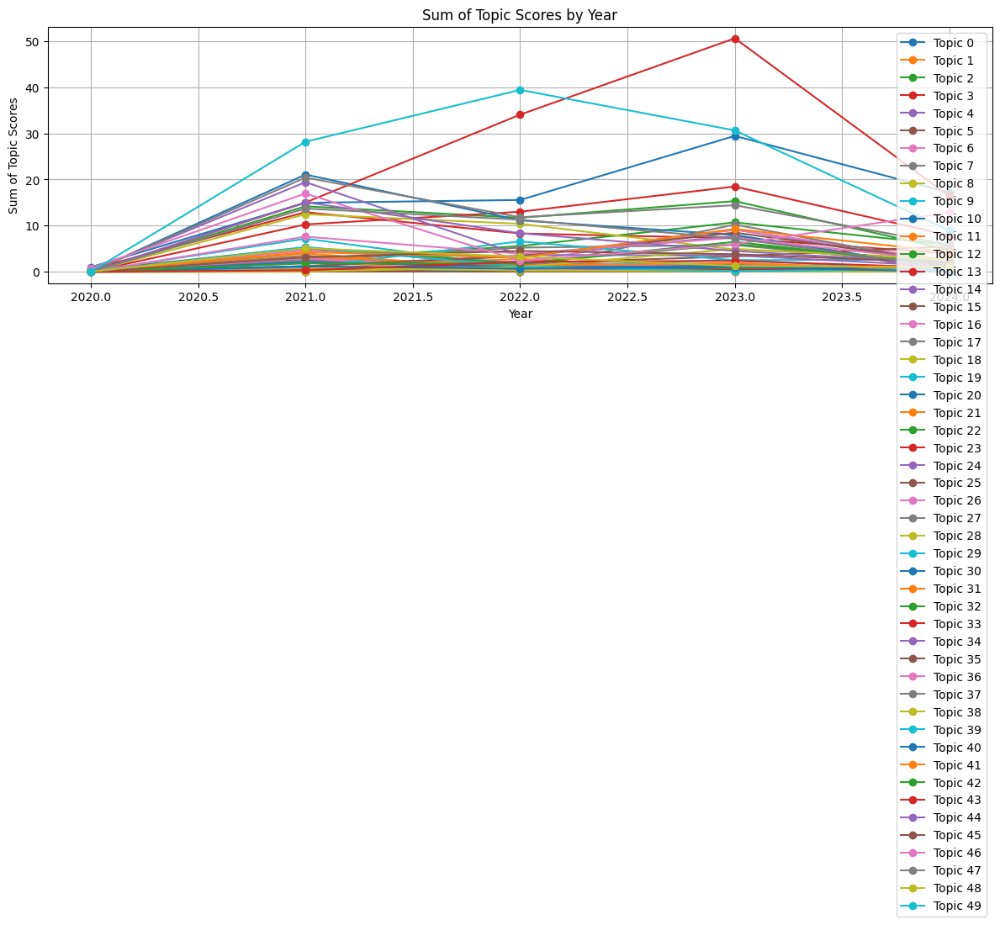

In [133]:
from collections import defaultdict
# Add a column for the year
df_copy['year'] = df_copy['date'].dt.year

# Initialize a dictionary to hold the sum of topic scores for each year
topic_scores_by_year = defaultdict(lambda: defaultdict(float))

# Sum the topic scores for each document by year
for i, doc in enumerate(doc_topics):
    year = df_copy.iloc[i]['year']
    for topic, score in doc:
        topic_scores_by_year[year][topic] += score

# Convert the dictionary to a DataFrame for easier analysis and visualization
topic_scores_df = pd.DataFrame(topic_scores_by_year).T

# Print the topic scores by year
print(topic_scores_df)

# Plot the topic scores by year
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
for topic in topic_scores_df.columns:
    plt.plot(topic_scores_df.index, topic_scores_df[topic], marker='o', label=f'Topic {topic}')

plt.title('Sum of Topic Scores by Year')
plt.xlabel('Year')
plt.ylabel('Sum of Topic Scores')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [134]:
df_copy['topic_scores'] = doc_topics

'''
# Display the topic scores for each article
for index, row in df_copy.iterrows():
    print(f"Article {index + 1}: {row['title']}")
    for topic, score in row['topic_scores']:
        print(f"    Topic {topic}: {score}")'''

'\n# Display the topic scores for each article\nfor index, row in df_copy.iterrows():\n    print(f"Article {index + 1}: {row[\'title\']}")\n    for topic, score in row[\'topic_scores\']:\n        print(f"    Topic {topic}: {score}")'

In [135]:
# Determine the dominant topic for each article and store it in a new column
df_copy['dominant_topic'] = df_copy['topic_scores'].apply(lambda topics: max(topics, key=lambda x: x[1])[0])

# Display the topic scores and dominant topic for each article
for index, row in df_copy.iterrows():
    print(f"Article {index + 1}: {row['title']}")
    for topic, score in row['topic_scores']:
        print(f"    Topic {topic}: {score}")
    print(f"    Dominant Topic: {row['dominant_topic']}")

# Print the DataFrame with the dominant topic for each article
print(df_copy[['title', 'dominant_topic']])

Article 1: Tomorrow, last day of the account at 2.89% APR and deposit at 3.44% APR from Renault Bank
    Topic 0: 0.00012821241398341954
    Topic 1: 0.00012821241398341954
    Topic 2: 0.00012821241398341954
    Topic 3: 0.00012821241398341954
    Topic 4: 0.00012821241398341954
    Topic 5: 0.00012821241398341954
    Topic 6: 0.00012821241398341954
    Topic 7: 0.00012821241398341954
    Topic 8: 0.00012821241398341954
    Topic 9: 0.00012821241398341954
    Topic 10: 0.00012821241398341954
    Topic 11: 0.00012821241398341954
    Topic 12: 0.00012821241398341954
    Topic 13: 0.993717610836029
    Topic 14: 0.00012821241398341954
    Topic 15: 0.00012821241398341954
    Topic 16: 0.00012821241398341954
    Topic 17: 0.00012821241398341954
    Topic 18: 0.00012821241398341954
    Topic 19: 0.00012821241398341954
    Topic 20: 0.00012821241398341954
    Topic 21: 0.00012821241398341954
    Topic 22: 0.00012821241398341954
    Topic 23: 0.00012821241398341954
    Topic 24: 0.0001282124

               0         1         2         3         4         5         6   \
2024-04  0.367730  0.961388  1.349742  0.002751  0.002751  0.159504  0.751944   
2024-03  0.002842  0.002842  1.300261  1.578264  0.013362  0.206177  0.804996   
2024-02  0.004166  0.004166  0.468535  1.617795  0.509608  0.312945  0.922896   
2024-01  0.003142  0.003142  1.612120  0.742589  1.009813  0.003142  0.003142   
2023-12  0.031647  0.100383  0.467432  0.002031  1.303176  0.002031  0.788472   
2023-11  0.003440  0.160627  3.428784  0.003440  0.371604  0.003440  0.383384   
2023-10  0.457419  0.039088  1.616073  1.070286  0.851256  0.003477  0.442724   
2023-09  0.158193  0.032471  1.304637  0.186669  1.370178  0.003053  2.394720   
2023-08  0.001987  0.001987  1.258796  0.001987  0.624865  0.055607  0.299742   
2023-07  0.001978  0.001978  1.489879  0.795196  0.115162  0.001978  0.246783   
2023-06  0.131547  0.002288  0.795807  0.503551  1.174097  0.002288  1.016988   
2023-05  0.264967  0.832965 

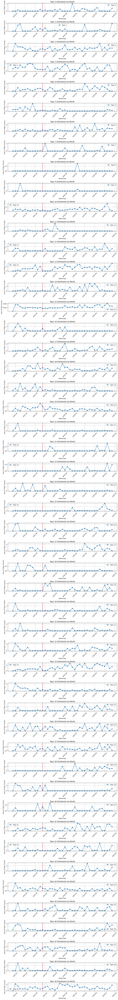

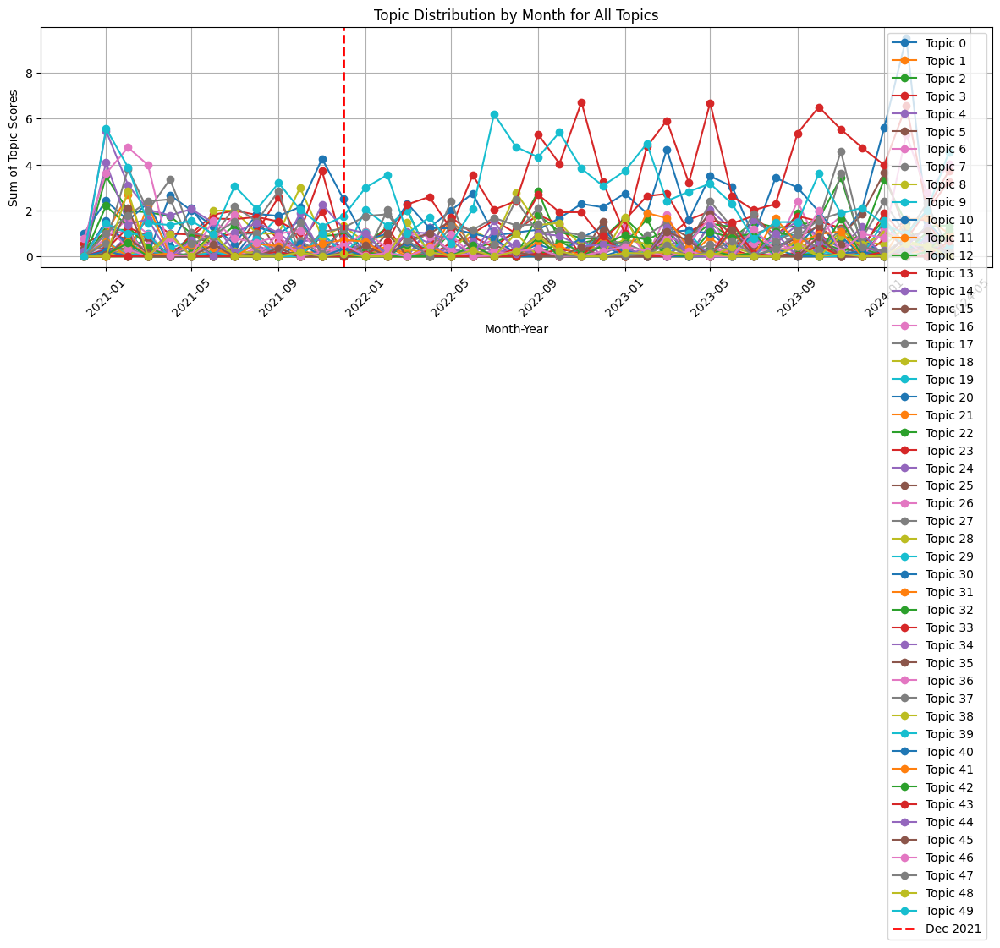

In [136]:
from collections import defaultdict

# Ensure date is in datetime format
df_copy['date'] = pd.to_datetime(df_copy['date'])

# Convert date to month-year format
df_copy['month_year'] = df_copy['date'].dt.to_period('M')

# Initialize a dictionary to hold the sum of topic scores for each month-year
topic_scores_by_month = defaultdict(lambda: defaultdict(float))

# Sum the topic scores for each document by month-year
for i, doc in enumerate(doc_topics):
    month_year = df_copy.iloc[i]['month_year']
    for topic, score in doc:
        topic_scores_by_month[month_year][topic] += score

# Convert the dictionary to a DataFrame for easier analysis and visualization
topic_scores_month_df = pd.DataFrame(topic_scores_by_month).T

# Print the topic scores by month-year
print(topic_scores_month_df)

# Plot the topic scores by month-year for each topic
fig, axs = plt.subplots(len(topic_scores_month_df.columns), 1, figsize=(12, 2 * len(topic_scores_month_df.columns)), tight_layout=True)

for i, topic in enumerate(topic_scores_month_df.columns):
    axs[i].plot(topic_scores_month_df.index.to_timestamp(), topic_scores_month_df[topic], marker='o', label=f'Topic {topic}')
    axs[i].set_title(f'Topic {topic} Distribution by Month')
    axs[i].set_xlabel('Month-Year')
    axs[i].set_ylabel('Sum of Topic Scores')
    axs[i].legend()
    axs[i].grid(True)
    axs[i].axvline(pd.Timestamp('2021-12-01'), color='red', linestyle='--', linewidth=2, label='Dec 2021')
    axs[i].xaxis.set_tick_params(rotation=45)

# Show the individual plots
plt.show()

# Plot all topics together in one plot
plt.figure(figsize=(12, 8))
for topic in topic_scores_month_df.columns:
    plt.plot(topic_scores_month_df.index.to_timestamp(), topic_scores_month_df[topic], marker='o', label=f'Topic {topic}')

plt.axvline(pd.Timestamp('2021-12-01'), color='red', linestyle='--', linewidth=2, label='Dec 2021')

plt.title('Topic Distribution by Month for All Topics')
plt.xlabel('Month-Year')
plt.ylabel('Sum of Topic Scores')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.xticks(rotation=45)
plt.show()

          13   2    33   43   42   49   41   46   17   36  ...   0    16   5   \
2024-04  3.0  2.0  3.0  1.0  1.0  5.0  1.0  5.0  1.0  1.0  ...  NaN  NaN  NaN   
2024-03  2.0  2.0  2.0  NaN  NaN  2.0  2.0  3.0  NaN  NaN  ...  NaN  NaN  NaN   
2024-02  1.0  1.0  7.0  NaN  NaN  1.0  1.0  6.0  NaN  1.0  ...  NaN  NaN  NaN   
2024-01  2.0  1.0  3.0  NaN  NaN  2.0  NaN  1.0  NaN  2.0  ...  NaN  NaN  NaN   
2023-12  1.0  1.0  4.0  NaN  NaN  3.0  NaN  1.0  NaN  NaN  ...  NaN  NaN  NaN   
2023-11  2.0  3.0  6.0  NaN  2.0  1.0  1.0  NaN  1.0  2.0  ...  NaN  NaN  NaN   
2023-10  2.0  3.0  7.0  NaN  NaN  4.0  1.0  2.0  NaN  1.0  ...  NaN  NaN  NaN   
2023-09  2.0  1.0  6.0  NaN  NaN  2.0  NaN  1.0  NaN  NaN  ...  NaN  NaN  NaN   
2023-08  1.0  2.0  2.0  NaN  NaN  3.0  2.0  NaN  2.0  1.0  ...  NaN  NaN  NaN   
2023-07  2.0  2.0  2.0  NaN  1.0  1.0  NaN  1.0  1.0  1.0  ...  NaN  NaN  NaN   
2023-06  3.0  1.0  1.0  2.0  1.0  4.0  1.0  NaN  NaN  NaN  ...  NaN  NaN  NaN   
2023-05  2.0  1.0  6.0  NaN 

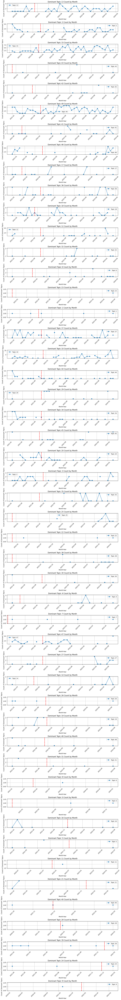

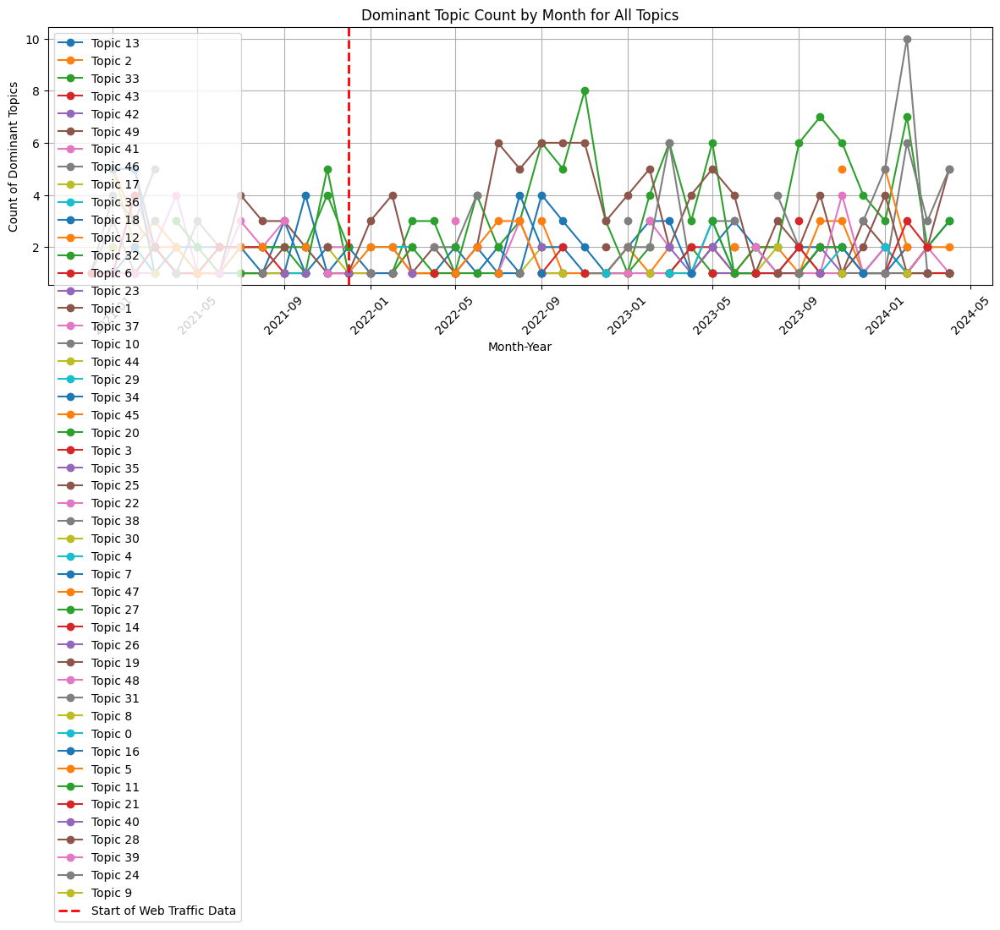

In [137]:
from collections import defaultdict

# Ensure date is in datetime format
df_copy['date'] = pd.to_datetime(df_copy['date'])

# Convert date to month-year format
df_copy['month_year'] = df_copy['date'].dt.to_period('M')

# Determine the dominant topic for each article and store it in a new column
df_copy['dominant_topic'] = df_copy['topic_scores'].apply(lambda topics: max(topics, key=lambda x: x[1])[0])

# Initialize a dictionary to hold the count of dominant topics for each month-year
dominant_topic_counts_by_month = defaultdict(lambda: defaultdict(int))

# Count the dominant topics for each document by month-year
for i, row in df_copy.iterrows():
    month_year = row['month_year']
    dominant_topic = row['dominant_topic']
    dominant_topic_counts_by_month[month_year][dominant_topic] += 1

# Convert the dictionary to a DataFrame for easier analysis and visualization
dominant_topic_counts_month_df = pd.DataFrame(dominant_topic_counts_by_month).T

# Print the dominant topic counts by month-year
print(dominant_topic_counts_month_df)

# Plot the dominant topic counts by month-year for each topic
fig, axs = plt.subplots(len(dominant_topic_counts_month_df.columns), 1, figsize=(12, 2 * len(dominant_topic_counts_month_df.columns)), tight_layout=True)

for i, topic in enumerate(dominant_topic_counts_month_df.columns):
    axs[i].plot(dominant_topic_counts_month_df.index.to_timestamp(), dominant_topic_counts_month_df[topic], marker='o', label=f'Topic {topic}')
    axs[i].set_title(f'Dominant Topic {topic} Count by Month')
    axs[i].set_xlabel('Month-Year')
    axs[i].set_ylabel('Count of Dominant Topics')
    axs[i].legend()
    axs[i].grid(True)
    axs[i].axvline(x=pd.Timestamp('2021-12-01'), color='red', linestyle='--', linewidth=2, label='Start of Web Traffic Data')
    axs[i].xaxis.set_tick_params(rotation=45)

# Show the individual plots
plt.show()

# Plot all dominant topics together in one plot
plt.figure(figsize=(12, 8))
for topic in dominant_topic_counts_month_df.columns:
    plt.plot(dominant_topic_counts_month_df.index.to_timestamp(), dominant_topic_counts_month_df[topic], marker='o', label=f'Topic {topic}')

plt.axvline(x=pd.Timestamp('2021-12-01'), color='red', linestyle='--', linewidth=2, label='Start of Web Traffic Data')
plt.title('Dominant Topic Count by Month for All Topics')
plt.xlabel('Month-Year')
plt.ylabel('Count of Dominant Topics')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.xticks(rotation=45)
plt.show()

            0         1          2          3         4         5         6   \
2024  0.377880  0.971538   4.730659   3.941399  1.535534  0.681769  2.482978   
2023  1.495172  1.181226  15.312500   7.272442  9.143914  0.084648  9.096078   
2022  1.676082  0.987348  11.700400   8.293853  3.192085  1.225529  2.210809   
2021  0.383384  2.904750  14.189051  12.911499  4.873217  5.241388  2.269331   
2020  0.000257  0.000257   0.000257   0.569275  0.000257  0.321053  0.000257   

            7         8         9   ...        40        41        42  \
2024  0.012901  0.012901  0.028818  ...  0.012901  4.270364  1.367285   
2023  1.546634  0.334190  0.241802  ...  1.017009  9.269100  6.481654   
2022  1.416135  0.023819  0.023819  ...  0.656769  3.064408  1.778925   
2021  0.487155  0.026055  1.074552  ...  1.166296  4.246480  1.803520   
2020  0.000257  0.000257  0.000257  ...  0.000257  0.000257  0.000257   

            43         44        45         46         47        48         49  

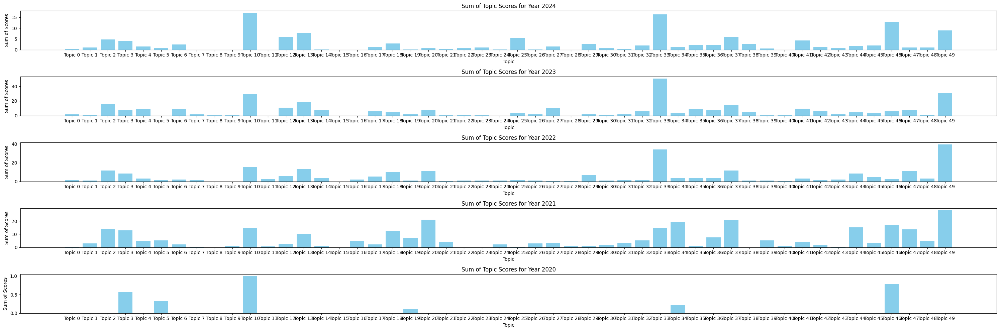

In [217]:
# Add a column for the year
df_copy['year'] = df_copy['date'].dt.year

# Initialize a dictionary to hold the sum of topic scores for each year
topic_scores_by_year = defaultdict(lambda: defaultdict(float))

# Sum the topic scores for each document by year
for i, doc in enumerate(doc_topics):
    year = df_copy.iloc[i]['year']
    for topic, score in doc:
        topic_scores_by_year[year][topic] += score

# Convert the dictionary to a DataFrame for easier analysis and visualization
topic_scores_df = pd.DataFrame(topic_scores_by_year).T

# Print the topic scores by year
print(topic_scores_df)

# Plot the topic scores by year using bar plots
years = topic_scores_df.index
num_topics = len(topic_scores_df.columns)

plt.figure(figsize=(30, 10))

for i, year in enumerate(years):
    plt.subplot(len(years), 1, i + 1)
    plt.bar(range(num_topics), topic_scores_df.loc[year], color='skyblue')
    plt.title(f'Sum of Topic Scores for Year {year}')
    plt.xlabel('Topic')
    plt.ylabel('Sum of Scores')
    plt.xticks(range(num_topics), [f'Topic {j}' for j in range(num_topics)])
    plt.tight_layout()

plt.show()

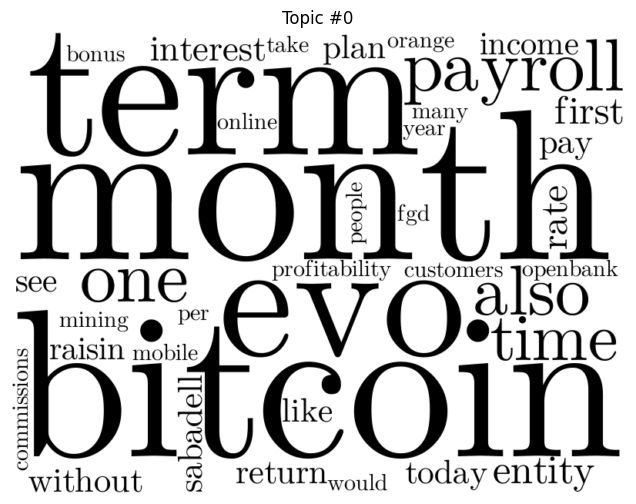

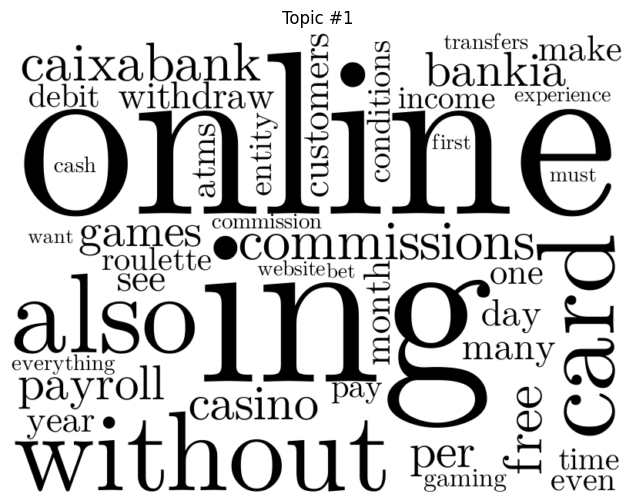

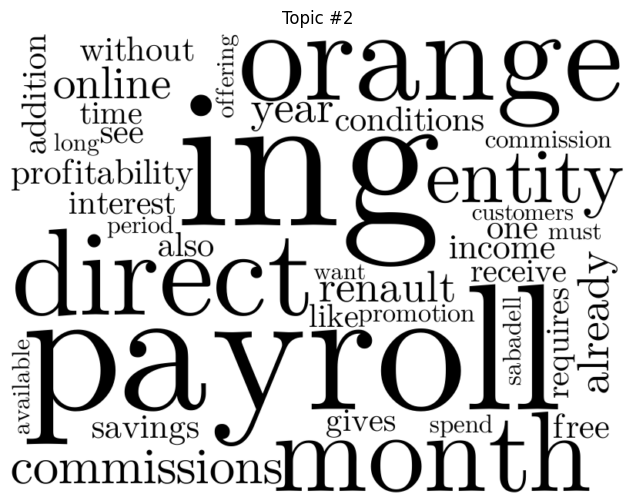

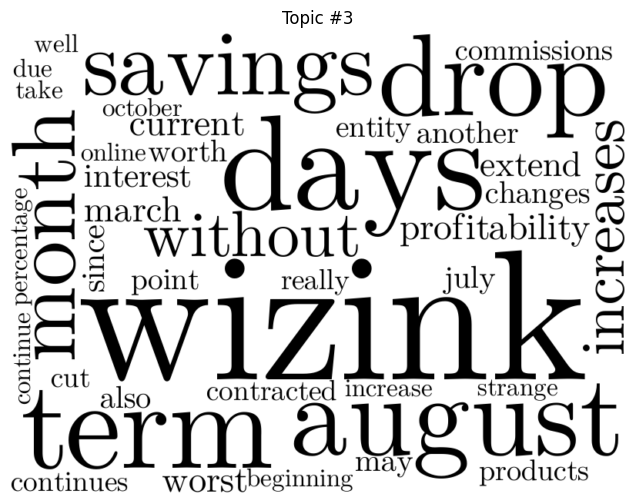

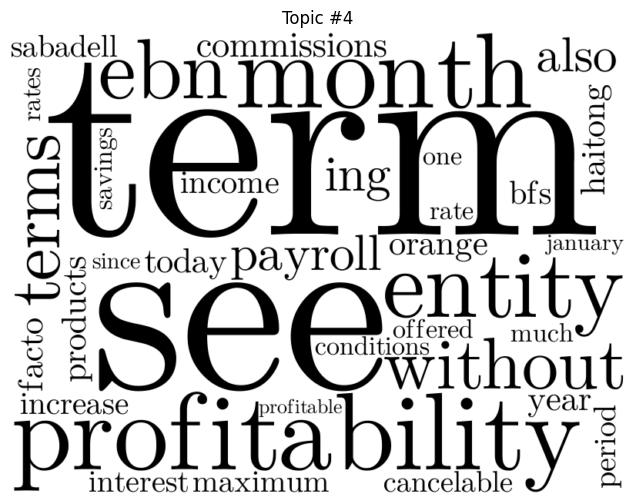

...

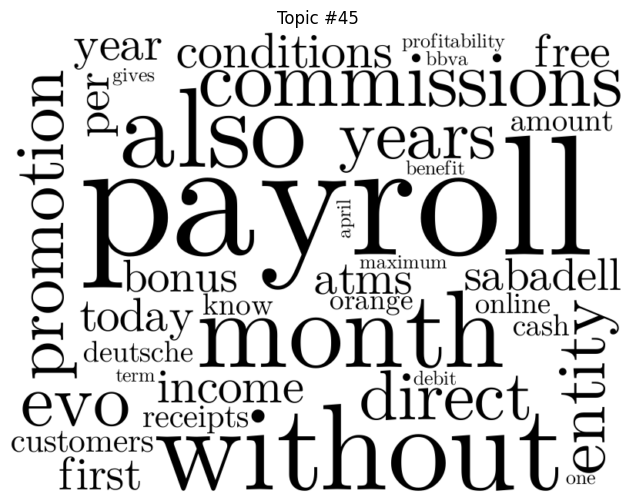

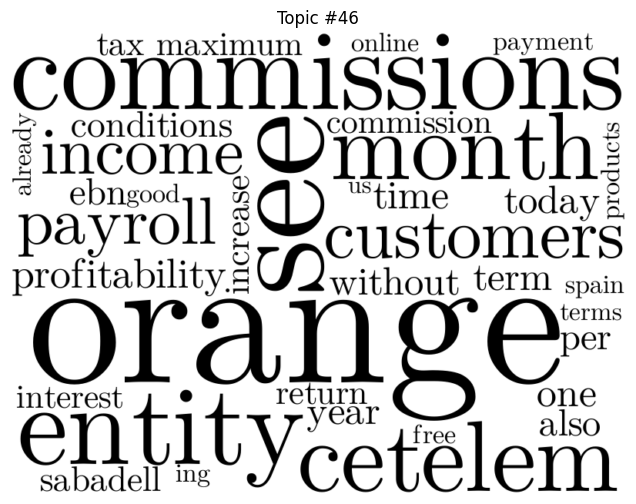

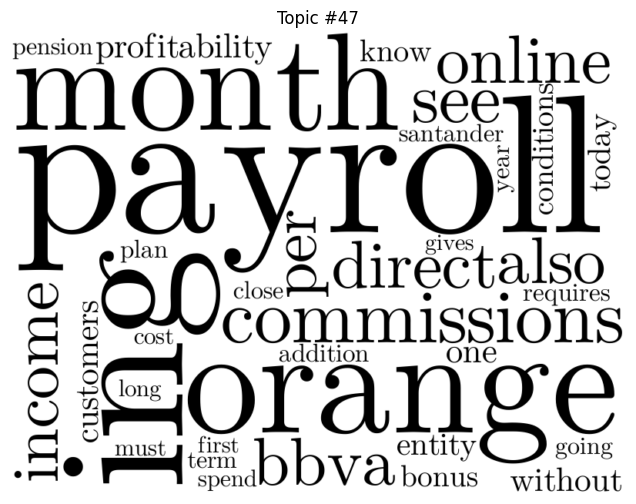

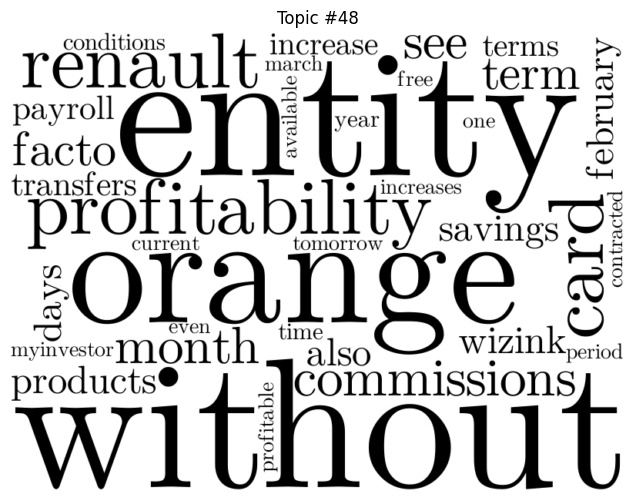

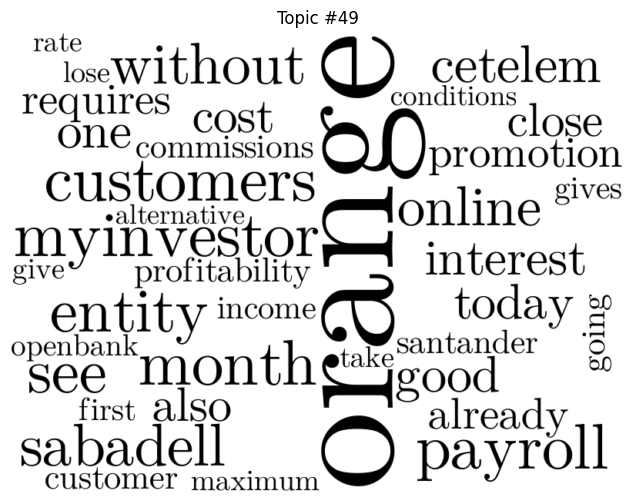

In [219]:
from wordcloud import WordCloud
import emojis
import matplotlib.pyplot as plt

# Define a font path that supports emojis
font_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/github_thesis/deloitte_digital_banking/tucapital_scraper/emoj_Symbola/Symbola.otf'

def generate_wordclouds(topics, dictionary, font_path, score_threshold=0.00001):
    excluded_words = {"bank", "banks", "apr", "client", "clients", "account", "accounts",
                      "deposit", "deposits", "banco", "new", "months", "offer", "offers", "money"}

    for topic_num, topic_words in topics:
        # Remove excluded words and apply score threshold
        filtered_topic_words = [(word, freq) for word, freq in topic_words if word.lower() not in excluded_words and freq >= score_threshold]

        word_freq = dict(filtered_topic_words)
        wordcloud = WordCloud(
            width=800,
            height=600,
            background_color='white',
            color_func=lambda *args, **kwargs: "black",  # Default color for non-emojis
            font_path=font_path,  # Specify emoji support
            min_font_size=10,
            regexp=r"\S+",  # Regular expression to include all non-whitespace characters
        ).generate_from_frequencies(word_freq)
        
        # Define a custom color function for emojis
        def color_func(word, font_size, position, orientation, random_state=None, **kwargs):
            if word in emojis.UNICODE_EMOJI:  # Check if the word is an emoji
                return "lightblue"  # Set color for emojis
            else:
                return "black"  # Default color for non-emojis
        
        # Apply the custom color function
        wordcloud.color_func = color_func
        
        plt.figure(figsize=(8, 6), facecolor=None)
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.axis("off")
        plt.title(f'Topic #{topic_num}')
        plt.show()

# Generate word clouds for each topic
generate_wordclouds(topics, lda_model.id2word, font_path, score_threshold=0.001)


In [146]:
df_copy.head(5)

,title,url,date,text,combined_text,word_count,year,year_month,topic_scores,dominant_topic,month_year
0,"Tomorrow, last day of the account at 2.89% APR...",https://www.tucapital.es/depositos/manana-ulti...,2024-04-23,"Tomorrow, April 24, 2024, the marketing period...",tomorrow last day account apr deposit apr rena...,318,2024,2024-04,"[(0, 0.00012821241), (1, 0.00012821241), (2, 0...",13,2024-04
1,ING gives you up to €120 if you direct your pa...,https://www.tucapital.es/cuentas/ing-te-da-has...,2024-04-22,"ING now asks, in addition to direct debiting a...",ing gives direct payroll pay card ing gives di...,400,2024,2024-04,"[(0, 0.00011907961), (1, 0.00011907961), (2, 0...",2,2024-04
2,Banco BIG deposits: slight increase in normal ...,https://www.tucapital.es/depositos/depositos-d...,2024-04-22,Banco BIG remodels its deposit offer with slig...,banco big deposits slight increase normal comb...,476,2024,2024-04,"[(0, 8.337077e-05), (1, 8.337077e-05), (2, 8.3...",33,2024-04
3,The future of Bitcoin: predictions for the nex...,https://www.tucapital.es/blogs/guias/el-futuro...,2024-04-22,"Since its launch, Bitcoin has seen positive an...",future bitcoin predictions next years future b...,656,2024,2024-04,"[(0, 5.2781972e-05), (1, 5.2781972e-05), (2, 5...",43,2024-04
4,Eco: Cetelem only allows maximum daily transfe...,https://www.tucapital.es/blogs/eco/eco-cetelem...,2024-04-19,"Due to the disappearance of Orange Bank, and t...",eco cetelem allows maximum daily transfers eco...,450,2024,2024-04,"[(0, 9.275735e-05), (1, 9.275735e-05), (2, 9.2...",42,2024-04


In [172]:
file_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/thesis project/data/Account Products.xlsx'
bank_df = pd.read_excel(file_path, sheet_name='account_products')

bank_df.head(5)

,Unnamed: 0,account product,bank,url - bank product information
0,1,Cuenta N26,N26,n26.com/es-es/cuenta-sin-comisiones
1,2,Cuenta Online Sabadell,Banc Sabadell,bancsabadell.com/cuenta-online
2,3,Cuenta Clara Abanca,ABANCA,abanca.com/es/cuentas/cuenta-online
3,4,Cuenta Inteligente Bienvenida Evo,EVO Banco,evobanco.com/cuenta-inteligente/
4,5,Cuenta No Cuenta,ING,ing.es/cuenta-nocuenta-ing


In [173]:
file_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/thesis project/data/Account Products_VF.xlsx'
bank_df = pd.read_excel(file_path, sheet_name='bank & accounts',skiprows=2)

bank_df.rename(columns={'url' : 'url - bank product information','account':'account product'}, inplace=True)
bank_df.head(5)

,Unnamed: 0,bank,account product,url - bank product information
0,1.0,abanca.com,Cuenta Online Clara,abanca.com/es/cuentas/cuenta-online
1,2.0,bancosantander.es,Cuenta Online Santander,bancosantander.es/particulares/cuentas-tarjeta...
2,3.0,bancsabadell.com,Cuenta Online Sabadell,bancsabadell.com/cuenta-online
3,4.0,bankinter.com,Cuenta Nómina Bankinter,bankinter.com/banca/cuentas-tarjetas/cuentas/c...
4,5.0,bbva.es,Cuenta Online Sin Comisiones,bbva.es/personas/productos/cuentas/cuenta-onli...


In [174]:
# Convert 'Account Product' in bank_df to lowercase
bank_df['account product'] = bank_df['account product'].str.lower()

merged_df = bank_df
merged_df['account product'].nunique()

12

In [175]:
cleaned_df = merged_df.dropna(subset=['account product'])

In [177]:
cleaned_df.rename(columns={'url - bank product information' : 'URL'}, inplace=True)

file_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/thesis project/data/Account Products_VF.xlsx'
web_traffic_df = pd.read_excel(file_path, sheet_name='Accounts Traffic (Desktop)', skiprows = 1)
web_traffic_df.head(5)

,Date,abanca.com/es/cuentas/cuenta-online,n26.com/es-es/cuenta-sin-comisiones,bancsabadell.com/cuenta-online,ing.es/cuenta-nocuenta-ing,bbva.es/personas/productos/cuentas/cuenta-online-sin-comisiones.html,revolut.com/es-ES/a-radically-better-account/,openbank.es/cuenta-ahorro-bienvenida,myinvestor.es/cuentas-tarjetas/cuentas,n26.com/es-es/cuenta-ahorro,bankinter.com/banca/cuentas-tarjetas/cuentas/cuenta-nomina,ing.es/cuenta-nomina-ing,evobanco.com/cuenta-inteligente,bancosantander.es/particulares/cuentas-tarjetas/cuentas-corrientes/cuenta-online-sin-comisiones,revolut.com/es-ES/a-radically-better-account/.1
0,2021-12-01,15202.983835,6664.368911,NaN,NaN,45449.486787,1343.418328,NaN,5319.608623,NaN,8733.560835,84404.564991,5055.542564,22325.885971,NaN
1,2022-01-01,42183.913207,5310.177360,NaN,NaN,38306.464983,1531.016801,NaN,6577.851993,NaN,11410.593443,110783.295080,4539.012047,28331.245044,NaN
2,2022-02-01,34498.153115,5547.588971,NaN,NaN,40978.325821,1304.591257,NaN,4031.716960,NaN,8891.661053,79688.098029,6049.457905,23798.819170,NaN
3,2022-03-01,34546.319021,4900.271300,NaN,NaN,43970.545627,1105.180575,NaN,4941.009311,NaN,7446.925144,80021.161861,9826.193608,24808.561729,NaN
4,2022-04-01,40508.288420,4909.581023,NaN,NaN,40782.451956,1020.968713,NaN,5774.734455,NaN,10285.861726,74071.446350,5028.236254,24739.758729,NaN


In [182]:
web_traffic_df = web_traffic_df.reset_index(drop=True)
# Melting the DataFrame
long_web_traffic_df = web_traffic_df.melt(id_vars=['Date'], var_name='URL', value_name='Web Traffic')


# Ensure no 'index' labels incorrectly positioned
print(long_web_traffic_df.head(5)), long_web_traffic_df['URL'].nunique()

        Date                                  URL   Web Traffic
0 2021-12-01  abanca.com/es/cuentas/cuenta-online  15202.983835
1 2022-01-01  abanca.com/es/cuentas/cuenta-online  42183.913207
2 2022-02-01  abanca.com/es/cuentas/cuenta-online  34498.153115
3 2022-03-01  abanca.com/es/cuentas/cuenta-online  34546.319021
4 2022-04-01  abanca.com/es/cuentas/cuenta-online  40508.288420


(None, 14)

In [183]:
long_web_traffic_df['Date'] = pd.to_datetime(long_web_traffic_df['Date'])

web_traffic_merged_df = pd.merge(
    cleaned_df, 
    long_web_traffic_df, 
    how='left', 
    on=['URL']
)

In [184]:
# Drop unnecessary columns
specific_category_df = web_traffic_merged_df.drop(columns=['Unnamed: 0', 'URL'])
specific_category_df.head(5)

,bank,account product,Date,Web Traffic
0,abanca.com,cuenta online clara,2021-12-01,15202.983835
1,abanca.com,cuenta online clara,2022-01-01,42183.913207
2,abanca.com,cuenta online clara,2022-02-01,34498.153115
3,abanca.com,cuenta online clara,2022-03-01,34546.319021
4,abanca.com,cuenta online clara,2022-04-01,40508.288420


In [186]:
df_copy.head(5)

,title,url,date,text,combined_text,word_count,year,year_month,topic_scores,dominant_topic,month_year
0,"Tomorrow, last day of the account at 2.89% APR...",https://www.tucapital.es/depositos/manana-ulti...,2024-04-23,"Tomorrow, April 24, 2024, the marketing period...",tomorrow last day account apr deposit apr rena...,318,2024,2024-04,"[(0, 0.00012821241), (1, 0.00012821241), (2, 0...",13,2024-04
1,ING gives you up to €120 if you direct your pa...,https://www.tucapital.es/cuentas/ing-te-da-has...,2024-04-22,"ING now asks, in addition to direct debiting a...",ing gives direct payroll pay card ing gives di...,400,2024,2024-04,"[(0, 0.00011907961), (1, 0.00011907961), (2, 0...",2,2024-04
2,Banco BIG deposits: slight increase in normal ...,https://www.tucapital.es/depositos/depositos-d...,2024-04-22,Banco BIG remodels its deposit offer with slig...,banco big deposits slight increase normal comb...,476,2024,2024-04,"[(0, 8.337077e-05), (1, 8.337077e-05), (2, 8.3...",33,2024-04
3,The future of Bitcoin: predictions for the nex...,https://www.tucapital.es/blogs/guias/el-futuro...,2024-04-22,"Since its launch, Bitcoin has seen positive an...",future bitcoin predictions next years future b...,656,2024,2024-04,"[(0, 5.2781972e-05), (1, 5.2781972e-05), (2, 5...",43,2024-04
4,Eco: Cetelem only allows maximum daily transfe...,https://www.tucapital.es/blogs/eco/eco-cetelem...,2024-04-19,"Due to the disappearance of Orange Bank, and t...",eco cetelem allows maximum daily transfers eco...,450,2024,2024-04,"[(0, 9.275735e-05), (1, 9.275735e-05), (2, 9.2...",42,2024-04


### Merge Article data with Web Traffic data ----- Prepararing for model

In [190]:
from collections import defaultdict

# Ensure 'date' is in datetime format and extract 'month_year'
df_copy['date'] = pd.to_datetime(df_copy['date'])
df_copy['month_year'] = df_copy['date'].dt.to_period('M').astype(str)

# Initialize a dictionary to hold the sum of topic scores for each month and account product
topic_scores_by_month = defaultdict(lambda: defaultdict(float))

# Sum the topic scores for each document by month_year
for i, row in df_copy.iterrows():
    month_year = row['month_year']
    for topic, score in row['topic_scores']:
        topic_scores_by_month[month_year][topic] += score

# Convert the dictionary to a DataFrame for easier analysis and visualization
topic_scores_df = pd.DataFrame(topic_scores_by_month).T.reset_index()
topic_scores_df.columns = ['month_year'] + [f'topic_{i}' for i in range(len(topic_scores_df.columns) - 1)]

# Display the topic scores by month
display(topic_scores_df.head(3))

,month_year,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,...,topic_40,topic_41,topic_42,topic_43,topic_44,topic_45,topic_46,topic_47,topic_48,topic_49
0,2024-04,0.367730,0.961388,1.349742,0.002751,0.002751,0.159504,0.751944,0.002751,0.002751,...,0.002751,0.997487,1.167297,0.654050,0.002751,0.002751,4.009953,0.190635,0.002751,4.530728
1,2024-03,0.002842,0.002842,1.300261,1.578264,0.013362,0.206177,0.804996,0.002842,0.002842,...,0.002842,1.649906,0.192680,0.002842,1.289563,1.113582,2.765268,0.379816,0.452317,2.002238
2,2024-02,0.004166,0.004166,0.468535,1.617795,0.509608,0.312945,0.922896,0.004166,0.004166,...,0.004166,1.619829,0.004166,0.025460,0.450227,0.843246,5.319773,0.184750,0.552523,0.958486


In [203]:
# Convert the 'Date' column in specific_category_df to period format for merging
specific_category_df['month_year'] = pd.to_datetime(specific_category_df['Date']).dt.to_period('M').astype(str)

# Merge the web traffic data with the aggregated topic scores data
merged_df = pd.merge(specific_category_df, topic_scores_df, on='month_year', how='left')

# Drop unnecessary columns
merged_df.drop(columns=['Date'], inplace=True)

# Display the first few rows of the merged dataframe
display(merged_df.head(3)),merged_df['Web Traffic'].isnull().count()

,bank,account product,Web Traffic,month_year,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,...,topic_40,topic_41,topic_42,topic_43,topic_44,topic_45,topic_46,topic_47,topic_48,topic_49
0,abanca.com,cuenta online clara,15202.983835,2021-12,0.001521,0.118802,0.973926,0.398638,0.398783,0.139348,...,0.331520,0.721358,0.001521,0.001521,1.222467,0.060417,0.515759,1.236432,0.113824,1.747777
1,abanca.com,cuenta online clara,42183.913207,2022-01,0.130406,0.392748,0.557789,0.404381,0.001596,0.117772,...,0.001596,0.641690,0.001596,0.073714,1.017024,0.486730,0.043881,1.753763,0.001596,2.989524
2,abanca.com,cuenta online clara,34498.153115,2022-02,0.001488,0.001488,1.271150,1.258482,0.351428,0.001488,...,0.001488,0.001488,0.003301,0.001488,0.001488,0.001488,0.147403,1.832947,0.006698,3.552254


(None, 349)

In [206]:
merged_df.dropna(subset=['Web Traffic'], inplace=True)

In [207]:
print("Number of NaNs in 'Web Traffic':", merged_df['Web Traffic'].isna().sum())

Number of NaNs in 'Web Traffic': 0


In [209]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Define features (topic scores) and target (web traffic)
X = merged_df.drop(columns=['Web Traffic', 'bank', 'account product', 'month_year'])
y = merged_df['Web Traffic']

print("Number of NaNs in features:", X.isna().sum().sum())
print("Number of NaNs in target:", y.isna().sum())

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the Random Forest model
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Make predictions and evaluate the model
y_pred = rf.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

# Feature importance
importance = rf.feature_importances_
feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': importance})
feature_importance_df.sort_values(by='Importance', ascending=False, inplace=True)
print(feature_importance_df)


Number of NaNs in features: 0
Number of NaNs in target: 0
Mean Squared Error: 475150563.19066185
     Feature  Importance
13  topic_13    0.066162
25  topic_25    0.040086
20  topic_20    0.040059
37  topic_37    0.034058
44  topic_44    0.033527
19  topic_19    0.031061
6    topic_6    0.031020
26  topic_26    0.029949
17  topic_17    0.028995
42  topic_42    0.027774
48  topic_48    0.027629
14  topic_14    0.027316
49  topic_49    0.026936
41  topic_41    0.023981
3    topic_3    0.023782
23  topic_23    0.023711
45  topic_45    0.023694
4    topic_4    0.022931
34  topic_34    0.022824
18  topic_18    0.022021
16  topic_16    0.021943
40  topic_40    0.021166
12  topic_12    0.021070
0    topic_0    0.020740
2    topic_2    0.019731
11  topic_11    0.019394
1    topic_1    0.019281
10  topic_10    0.019147
43  topic_43    0.018138
33  topic_33    0.017077
22  topic_22    0.015915
47  topic_47    0.015305
39  topic_39    0.015178
29  topic_29    0.014919
32  topic_32    0.012829
36 

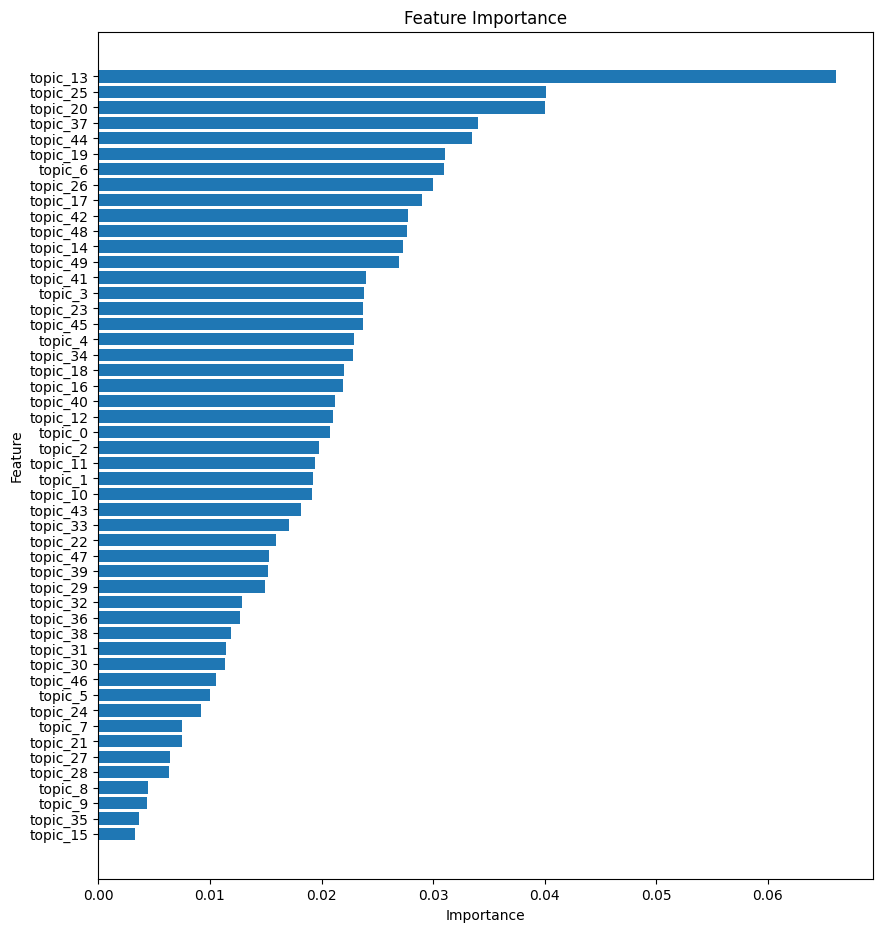

In [212]:
import matplotlib.pyplot as plt

# Plot feature importance
plt.figure(figsize=(10, 11))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance')
plt.gca().invert_yaxis()
plt.show()


In [213]:
from sklearn.model_selection import cross_val_score, GridSearchCV

# Define the parameter grid
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Initialize the Random Forest model
rf = RandomForestRegressor(random_state=42)

# Initialize the Grid Search
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

# Fit the Grid Search to the data
grid_search.fit(X_train, y_train)

# Best parameters and best score
print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Score: {grid_search.best_score_}")

# Evaluate the best model
best_rf = grid_search.best_estimator_
y_pred = best_rf.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f'Improved Mean Squared Error: {mse}')


Fitting 5 folds for each of 108 candidates, totalling 540 fits
Best Parameters: {'max_depth': None, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 200}
Best Score: -0.2567030490569783
Improved Mean Squared Error: 460372513.9843824


R-squared: -0.19478892458606367
Mean Absolute Error: 18925.047697758615
Mean Squared Error: 460372513.9843824


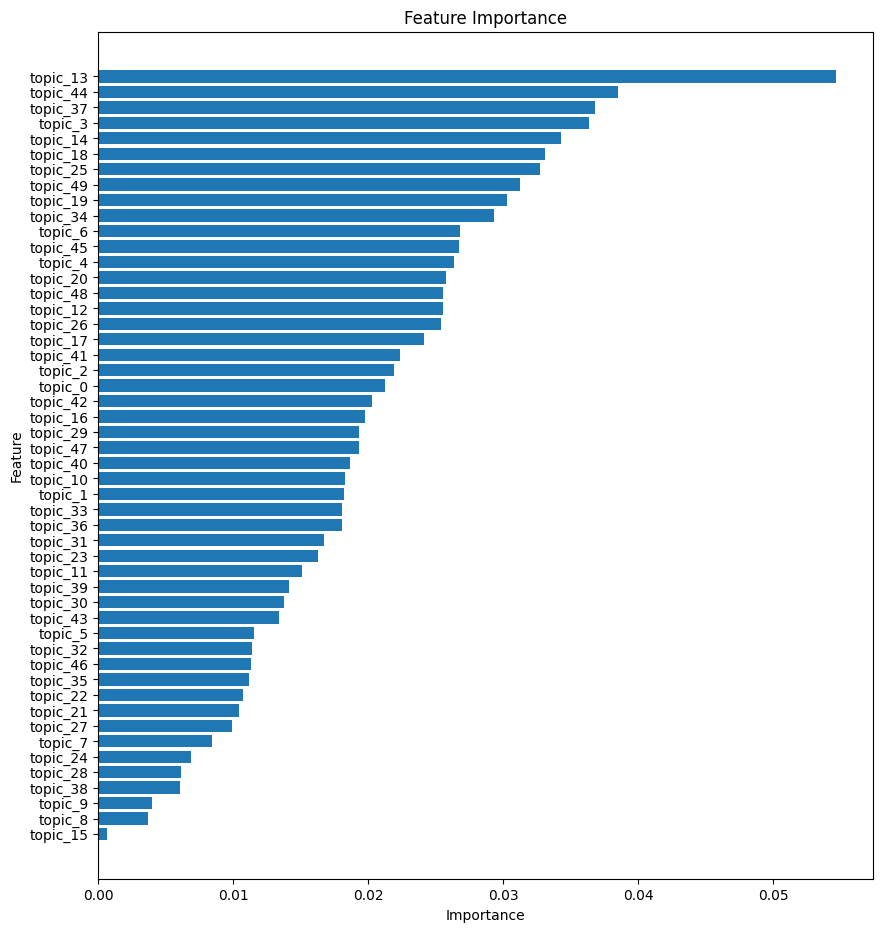

In [215]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Calculate R-squared, Mean Absolute Error (MAE), and Mean Squared Error (MSE)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print(f'R-squared: {r2}')
print(f'Mean Absolute Error: {mae}')
print(f'Mean Squared Error: {mse}')

# Plot feature importance
import matplotlib.pyplot as plt

# Feature importance
importance = best_rf.feature_importances_
feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': importance})
feature_importance_df.sort_values(by='Importance', ascending=False, inplace=True)

plt.figure(figsize=(10, 11))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance')
plt.gca().invert_yaxis()
plt.show()


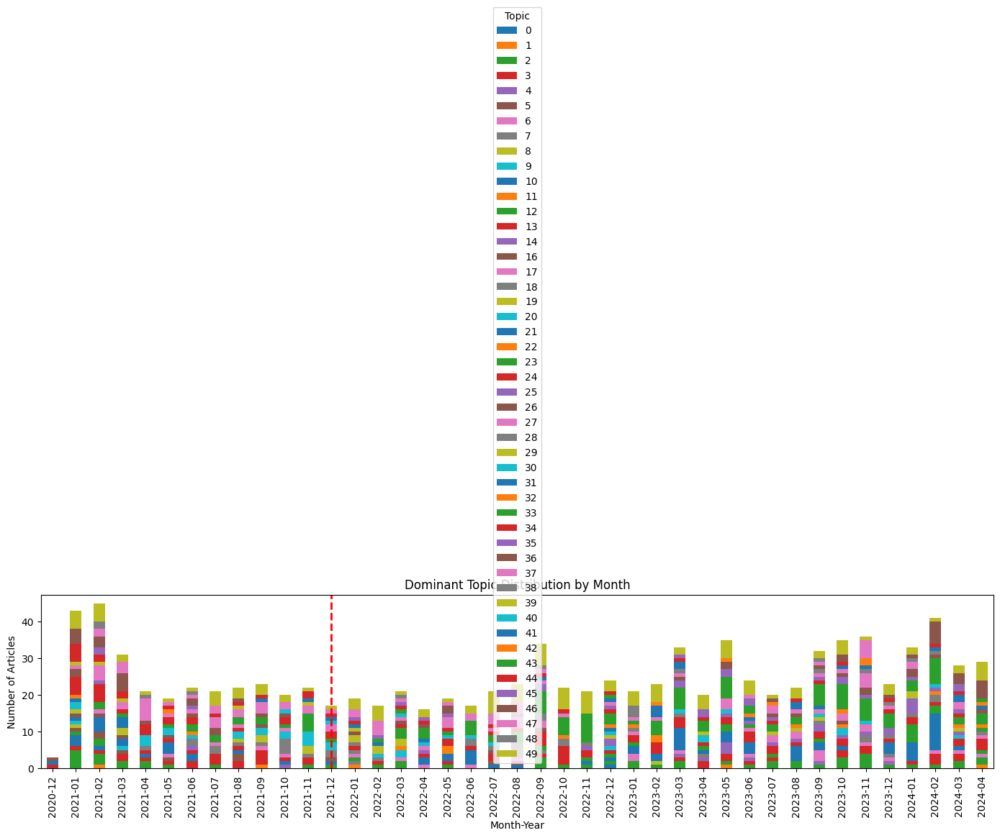

In [233]:
# Add a column for the dominant topic in each document
df_copy['dominant_topic'] = [max(doc, key=lambda x: x[1])[0] for doc in doc_topics]

# Group by month and dominant topic to see the distribution
dominant_topic_distribution = df_copy.groupby(['month_year', 'dominant_topic']).size().unstack(fill_value=0)

# Plot the dominant topic distribution by month
dominant_topic_distribution.plot(kind='bar', stacked=True, figsize=(14, 8))
plt.title('Dominant Topic Distribution by Month')
plt.xlabel('Month-Year')
plt.ylabel('Number of Articles')
plt.legend(title='Topic')
plt.axvline(x=dominant_topic_distribution.index.get_loc('2021-12'), color='red', linestyle='--', linewidth=2, label='Start of Web Traffic Data')
plt.tight_layout()
plt.show()


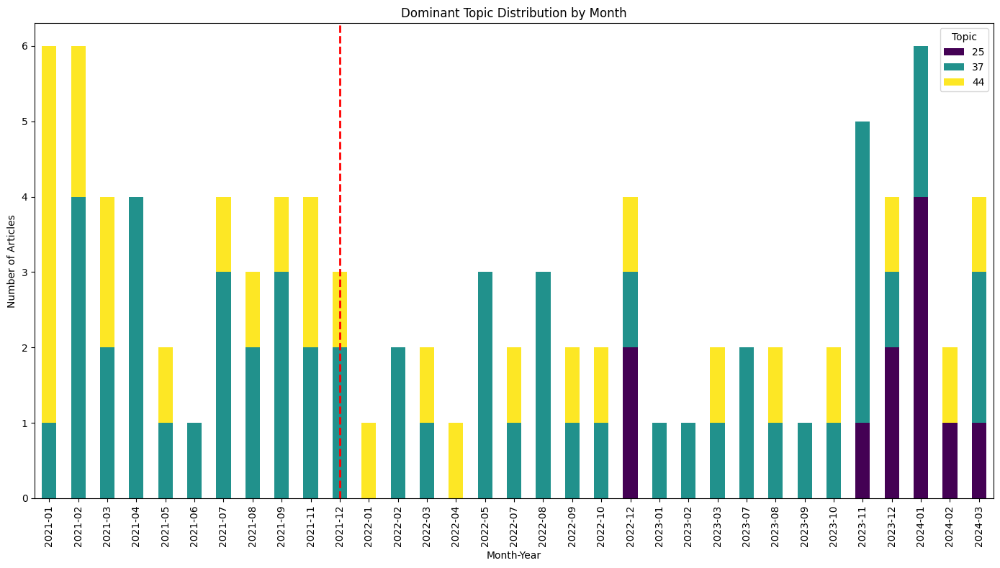

In [241]:
import matplotlib.pyplot as plt

# Add a column for the dominant topic in each document
df_copy['dominant_topic'] = [max(doc, key=lambda x: x[1])[0] for doc in doc_topics]

# Filter the DataFrame to include only the desired topics
desired_topics = [44, 37, 25]
filtered_df_copy = df_copy[df_copy['dominant_topic'].isin(desired_topics)]

# Group by month and dominant topic to see the distribution
dominant_topic_distribution = filtered_df_copy.groupby(['month_year', 'dominant_topic']).size().unstack(fill_value=0)

# Plot the dominant topic distribution by month
dominant_topic_distribution.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='viridis')
plt.title('Dominant Topic Distribution by Month')
plt.xlabel('Month-Year')
plt.ylabel('Number of Articles')
plt.legend(title='Topic')
plt.axvline(x=dominant_topic_distribution.index.get_loc('2021-12'), color='red', linestyle='--', linewidth=2, label='Start of Web Traffic Data')
plt.tight_layout()
plt.show()


In [221]:
csv_file_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/thesis project/data/df_copy.csv'

# Save the DataFrame to a CSV file
df_copy.to_csv(csv_file_path, index=False)

In [231]:
df_copy.columns

Index(['title', 'url', 'date', 'text', 'combined_text', 'word_count', 'year',
       'year_month', 'topic_scores', 'dominant_topic', 'month_year'],
      dtype='object')

In [242]:
from collections import defaultdict

# Ensure 'date' is in datetime format and extract 'month_year'
df_copy['date'] = pd.to_datetime(df_copy['date'])
df_copy['month_year'] = df_copy['date'].dt.to_period('M').astype(str)

# Initialize a dictionary to hold the sum of topic scores for each month
topic_scores_by_month = defaultdict(lambda: defaultdict(float))

# Sum the topic scores for each document by month_year
for i, row in df_copy.iterrows():
    month_year = row['month_year']
    for topic, score in row['topic_scores']:
        topic_scores_by_month[month_year][topic] += score

# Convert the dictionary to a DataFrame for easier analysis and visualization
topic_scores_df = pd.DataFrame(topic_scores_by_month).T.reset_index()

# Set the column names correctly (adjusting for the actual number of topics)
num_topics = len(topic_scores_df.columns) - 1
column_names = ['month_year'] + [f'topic_{i}' for i in range(num_topics)]
topic_scores_df.columns = column_names

# Keep only the desired topics
desired_topics = ['month_year', 'topic_44', 'topic_37', 'topic_25']
topic_scores_df = topic_scores_df[desired_topics]

# Merge the desired columns from df_copy with the topic scores DataFrame
df_copy_filtered = df_copy[['title', 'url', 'date', 'combined_text', 'text', 'month_year', 'dominant_topic','topic_scores']]
merged_df = pd.merge(df_copy_filtered, topic_scores_df, on='month_year', how='left')

In [244]:
# Save the DataFrame to a CSV file
csv_file_path = 'D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/thesis project/data/df_copy_filtered.csv'
merged_df.to_csv(csv_file_path, index=False)

print(f'DataFrame saved to {csv_file_path}')

DataFrame saved to D:/Hangze Wu/BSE/DSDM/semester3/Master Thesis/thesis project/data/df_copy_filtered.csv
